In [1]:
import pandas as pd
import numpy as np

import seaborn as sns
%matplotlib inline
import matplotlib.pyplot as plt

In [20]:
sns.set_theme(style="darkgrid", palette="muted", rc={"figure.figsize": (10, 6)})

# Visualizations for Final Datset

Creating finalized style for visualizations in the dataset. Initial prototyping led to creation of functions for different plot types. Some Bivariate Analysis included as well.

## Basic Read-in

In [104]:
df = pd.read_csv("nfl_merged_wide_format_no_multicollinearity.csv")
df

,Player Name,2022 Age,2022 Position,2022 Team,2022 Games Played,2022 Games Started,2022 Total Passing,2022 Interceptions Thrown,2022 Rushing Touchdowns,2022 Carries*Yards,...,2024 Extra Points Made,2024 ST_Interceptions,2024 ST_Safeties,2024 ST_Special Teams Touchdowns,2024 XP2,2024 Touchdowns Allowed,2024 Average ADP,2024 Positional ADP,2024 PPR Fantasy Points Scored,2024 Standard Fantasy Points Scored
0,A.J. Brown,25.0,WR,PHI,17.0,16.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,10.2,6.0,216.9,149.9
1,A.J. Green,34.0,WR,ARI,15.0,10.0,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,A.J. McCarron,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,A.T. Perry,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AJ Barner,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,395.0,58.0,78.5,48.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
965,Zander Horvath,24.0,RB,LAC,15.0,2.0,NaN,NaN,0.0,36.0,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
966,Zane Gonzalez,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,19.0,NaN,NaN,NaN,NaN,NaN,900.0,211.0,36.0,36.0
967,Zay Flowers,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,63.2,28.0,209.5,135.5
968,Zay Jones,27.0,WR,JAX,16.0,15.0,NaN,NaN,0.0,76.0,...,NaN,NaN,NaN,NaN,NaN,NaN,314.5,104.0,16.4,8.4


In [106]:
df.describe()

,2022 Age,2022 Games Played,2022 Games Started,2022 Total Passing,2022 Interceptions Thrown,2022 Rushing Touchdowns,2022 Carries*Yards,2022 Receiving Touchdowns,2022 Receptions*Yards,2022 Fumbles,...,2024 Extra Points Made,2024 ST_Interceptions,2024 ST_Safeties,2024 ST_Special Teams Touchdowns,2024 XP2,2024 Touchdowns Allowed,2024 Average ADP,2024 Positional ADP,2024 PPR Fantasy Points Scored,2024 Standard Fantasy Points Scored
count,654.000000,686.000000,686.000000,99.000000,99.000000,349.000000,349.000000,482.000000,482.000000,586.000000,...,61.000000,32.000000,32.000000,32.000000,22.000000,32.000000,663.000000,663.000000,663.000000,663.000000
mean,26.435780,11.959184,5.476676,25505.171717,4.222222,1.395415,28936.200573,1.553942,13969.524896,1.039249,...,19.491803,12.093750,0.468750,2.000000,1.409091,41.250000,374.246456,79.601810,79.342413,61.826576
std,3.482796,5.280574,6.136540,44877.079149,4.339086,2.599421,76908.509701,2.229596,28523.846210,1.969033,...,17.691451,4.416679,0.671271,1.367833,0.590326,6.455805,260.774983,64.238731,84.473830,71.585064
min,21.000000,1.000000,0.000000,0.000000,0.000000,0.000000,-34.000000,0.000000,-18.000000,0.000000,...,0.000000,4.000000,0.000000,0.000000,1.000000,31.000000,1.000000,1.000000,-8.700000,-9.700000
25%,24.000000,8.000000,0.000000,63.500000,0.000000,0.000000,36.000000,0.000000,165.000000,0.000000,...,0.000000,9.000000,0.000000,1.000000,1.000000,37.000000,169.800000,27.000000,10.500000,5.300000
50%,26.000000,14.000000,2.000000,1560.000000,3.000000,0.000000,480.000000,1.000000,1815.000000,0.000000,...,18.000000,12.500000,0.000000,2.000000,1.000000,40.500000,316.000000,63.000000,51.800000,35.800000
75%,28.000000,17.000000,11.000000,35504.000000,7.000000,1.000000,8970.000000,2.000000,14132.250000,1.000000,...,32.000000,15.000000,1.000000,3.000000,2.000000,45.000000,529.250000,115.000000,123.000000,96.900000
max,45.000000,17.000000,17.000000,220500.000000,15.000000,17.000000,562360.000000,14.000000,231680.000000,16.000000,...,64.000000,24.000000,2.000000,5.000000,3.000000,59.000000,900.000000,211.000000,420.380000,420.380000


In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 970 entries, 0 to 969
Data columns (total 70 columns):
 #   Column                               Non-Null Count  Dtype  
---  ------                               --------------  -----  
 0   Player Name                          970 non-null    object 
 1   2022 Age                             654 non-null    float64
 2   2022 Position                        686 non-null    object 
 3   2022 Team                            686 non-null    object 
 4   2022 Games Played                    686 non-null    float64
 5   2022 Games Started                   686 non-null    float64
 6   2022 Total Passing                   113 non-null    float64
 7   2022 Interceptions Thrown            113 non-null    float64
 8   2022 Rushing Touchdowns              586 non-null    float64
 9   2022 Carries*Yards                   586 non-null    float64
 10  2022 Receiving Touchdowns            586 non-null    float64
 11  2022 Receptions*Yards           

In [102]:
feature_cols = ['Age', 'Games Played', 'Games Started', 'Total Passing',
'Interceptions Thrown', 'Rushing Touchdowns', 'Carries*Yards', 'Receiving Touchdowns',
'Receptions*Yards', 'Fumbles', 'Field Goals Made', 'Extra Points Made',
'ST_Interceptions', 'ST_Safeties', 'ST_Special Teams Touchdowns', 'XP2',
'Touchdowns Allowed', 'Average ADP', 'Positional ADP',
'PPR Fantasy Points Scored', 'Standard Fantasy Points Scored']

## Fantasy Points by Position and Team

### Position

#### 2022

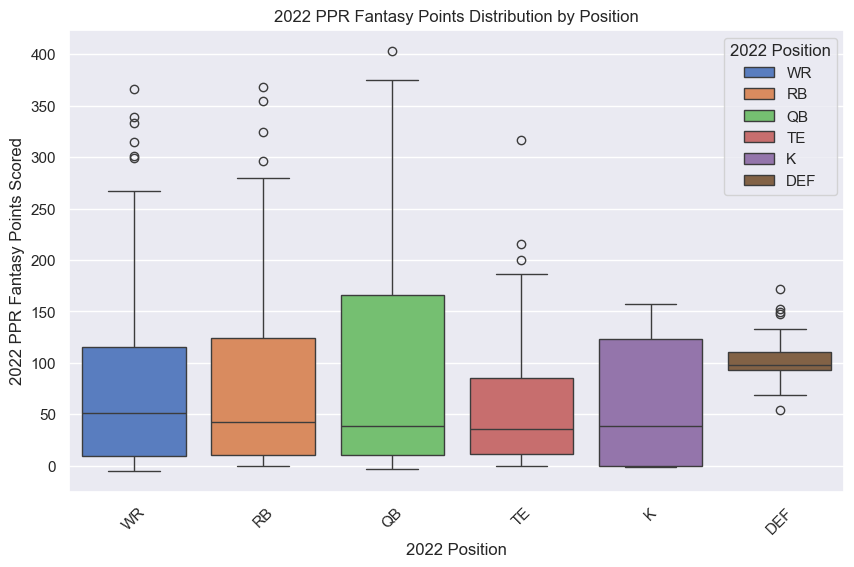

In [29]:
sns.boxplot(x="2022 Position", y='2022 PPR Fantasy Points Scored', data=df, hue='2022 Position')
plt.title("2022 PPR Fantasy Points Distribution by Position")
plt.xticks(rotation=45)
plt.show()

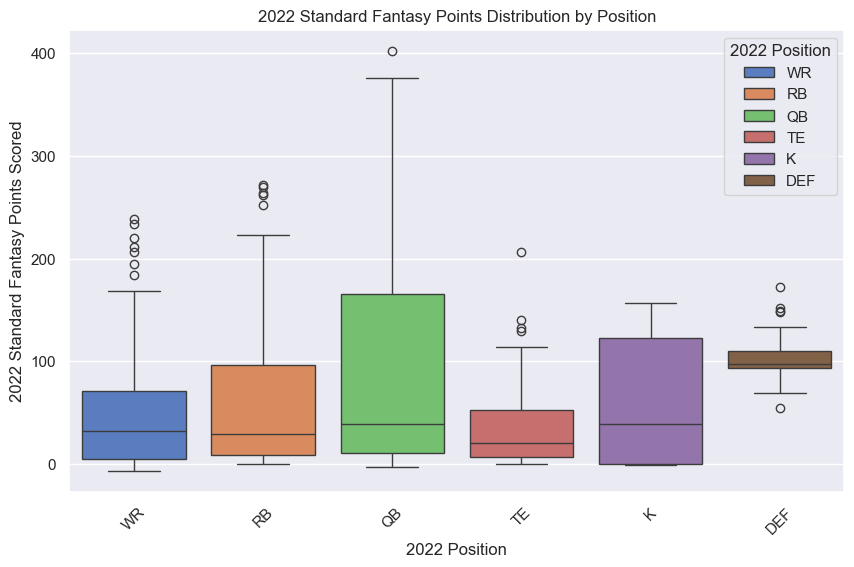

In [24]:
sns.boxplot(x="2022 Position", y='2022 Standard Fantasy Points Scored', data=df, hue='2022 Position')
plt.title("2022 Standard Fantasy Points Distribution by Position")
plt.xticks(rotation=45)
plt.show()

#### 2023

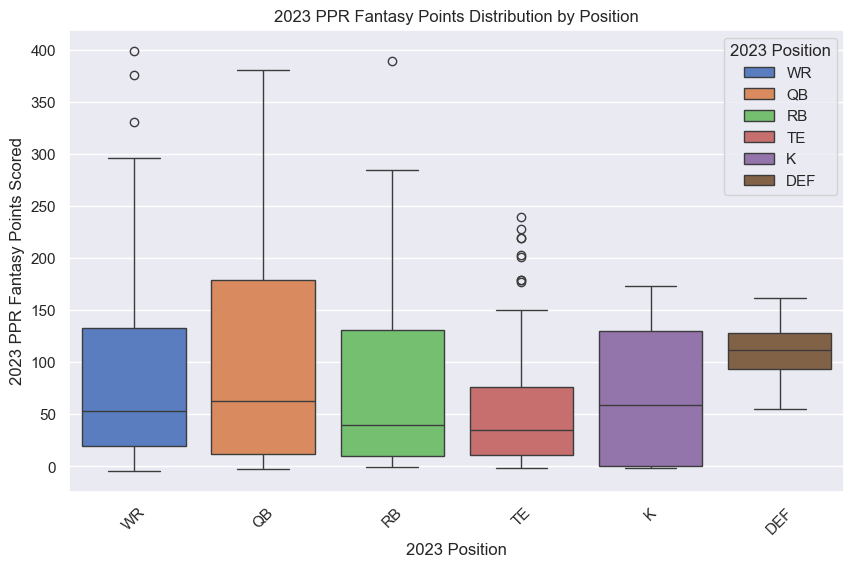

In [7]:
sns.boxplot(x="2023 Position", y='2023 PPR Fantasy Points Scored', data=df, hue='2023 Position')
plt.title("2023 PPR Fantasy Points Distribution by Position")
plt.xticks(rotation=45)
plt.show()

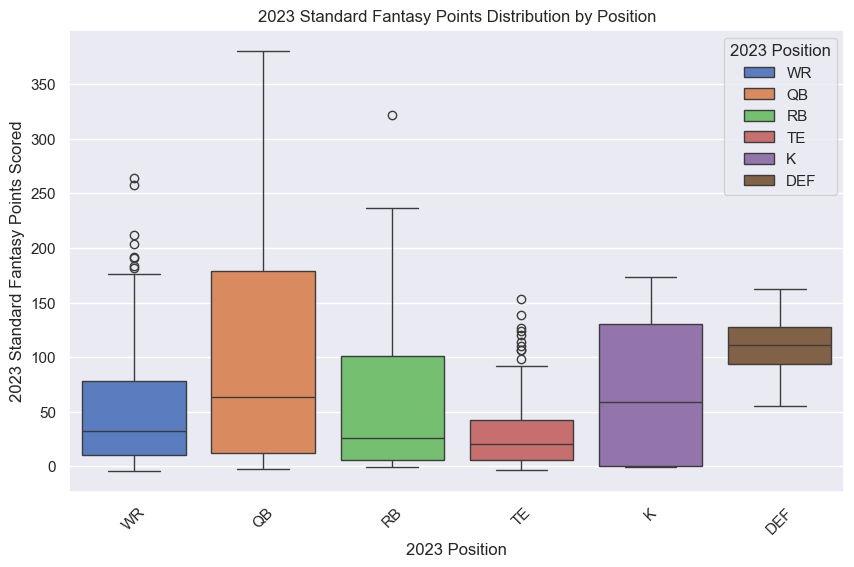

In [25]:
sns.boxplot(x="2023 Position", y='2023 Standard Fantasy Points Scored', data=df, hue='2023 Position')
plt.title("2023 Standard Fantasy Points Distribution by Position")
plt.xticks(rotation=45)
plt.show()

#### 2024

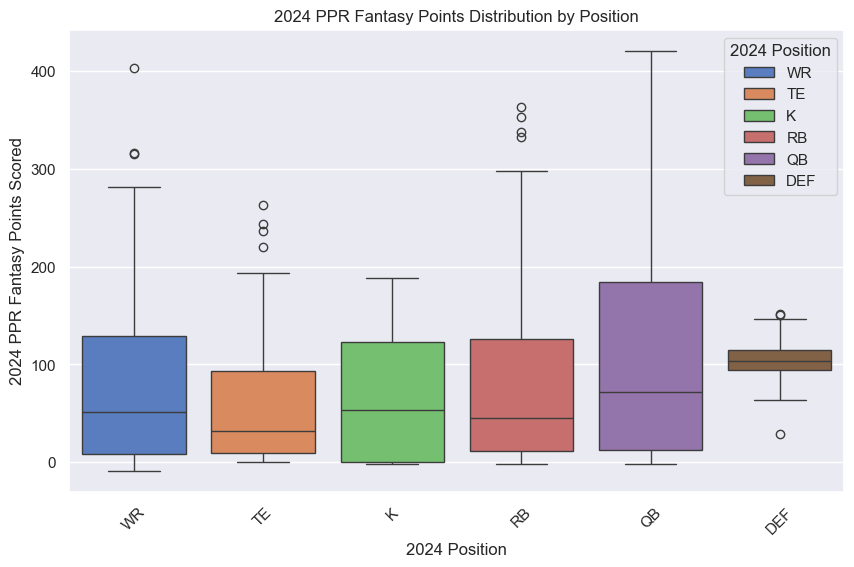

In [8]:
sns.boxplot(x="2024 Position", y='2024 PPR Fantasy Points Scored', data=df, hue='2024 Position')
plt.title("2024 PPR Fantasy Points Distribution by Position")
plt.xticks(rotation=45)
plt.show()

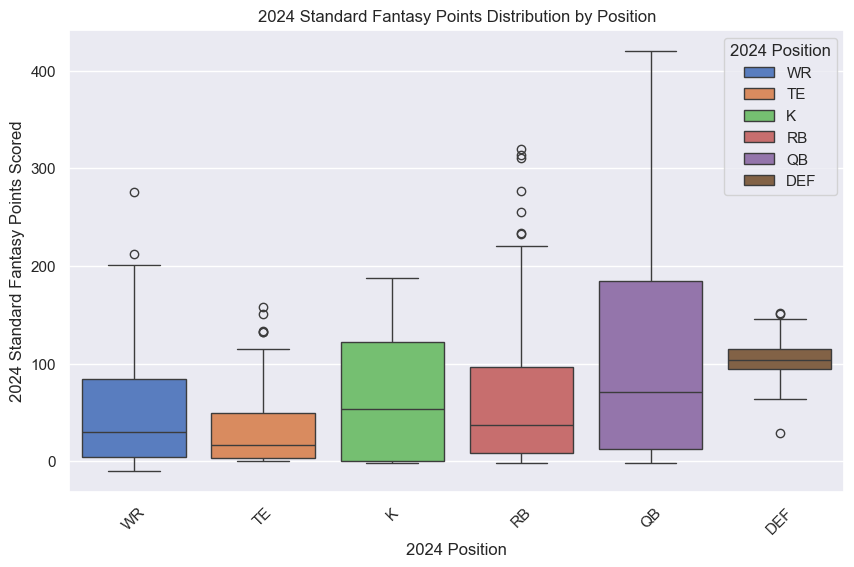

In [26]:
sns.boxplot(x="2024 Position", y='2024 Standard Fantasy Points Scored', data=df, hue='2024 Position')
plt.title("2024 Standard Fantasy Points Distribution by Position")
plt.xticks(rotation=45)
plt.show()

### Team

#### 2022

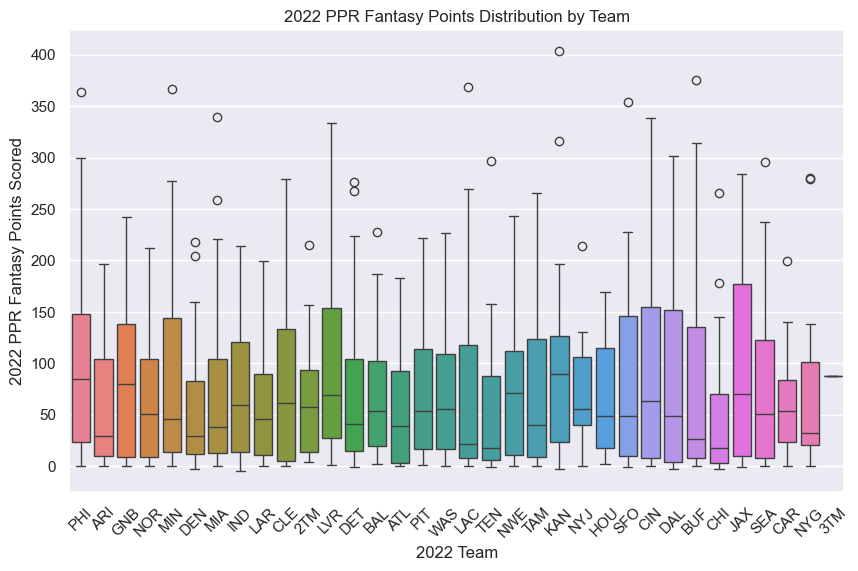

In [20]:
sns.boxplot(x="2022 Team", y='2022 PPR Fantasy Points Scored', data=df, hue='2022 Team', legend=False)
plt.title("2022 PPR Fantasy Points Distribution by Team")
plt.xticks(rotation=45)
plt.show()

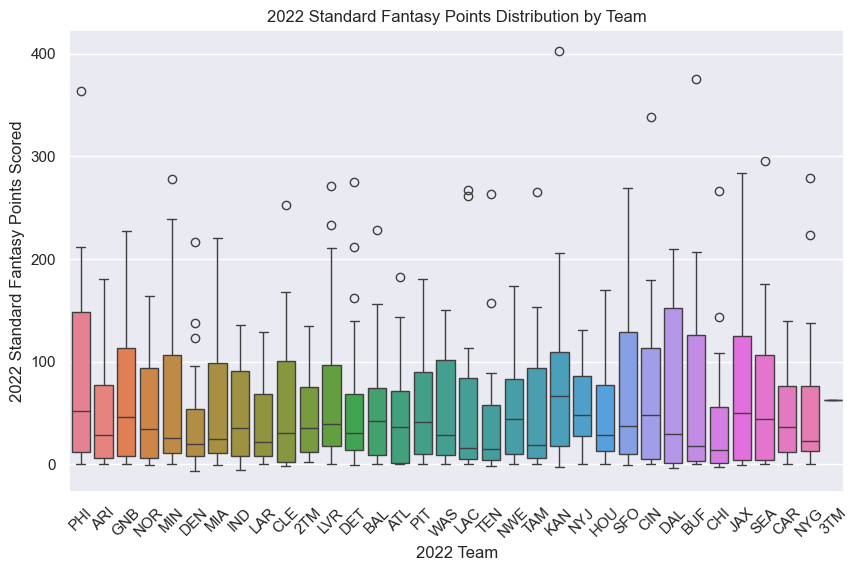

In [27]:
sns.boxplot(x="2022 Team", y='2022 Standard Fantasy Points Scored', data=df, hue='2022 Team', legend=False)
plt.title("2022 Standard Fantasy Points Distribution by Team")
plt.xticks(rotation=45)
plt.show()

#### 2023

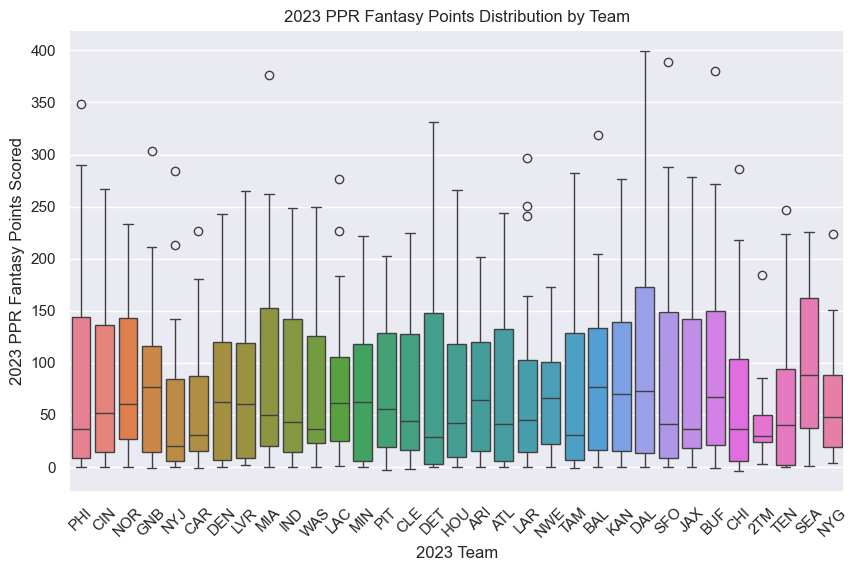

In [21]:
sns.boxplot(x="2023 Team", y='2023 PPR Fantasy Points Scored', data=df, hue='2023 Team', legend=False)
plt.title("2023 PPR Fantasy Points Distribution by Team")
plt.xticks(rotation=45)
plt.show()

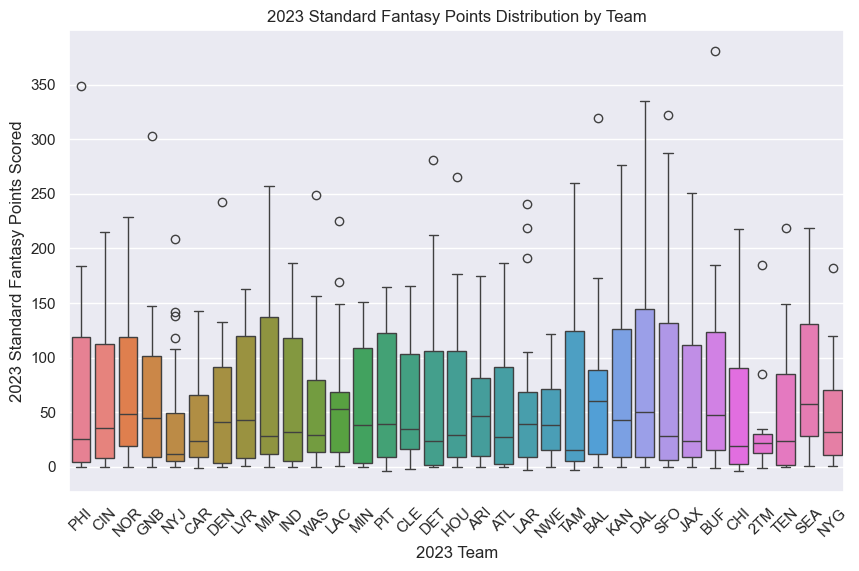

In [28]:
sns.boxplot(x="2023 Team", y='2023 Standard Fantasy Points Scored', data=df, hue='2023 Team', legend=False)
plt.title("2023 Standard Fantasy Points Distribution by Team")
plt.xticks(rotation=45)
plt.show()

#### 2024

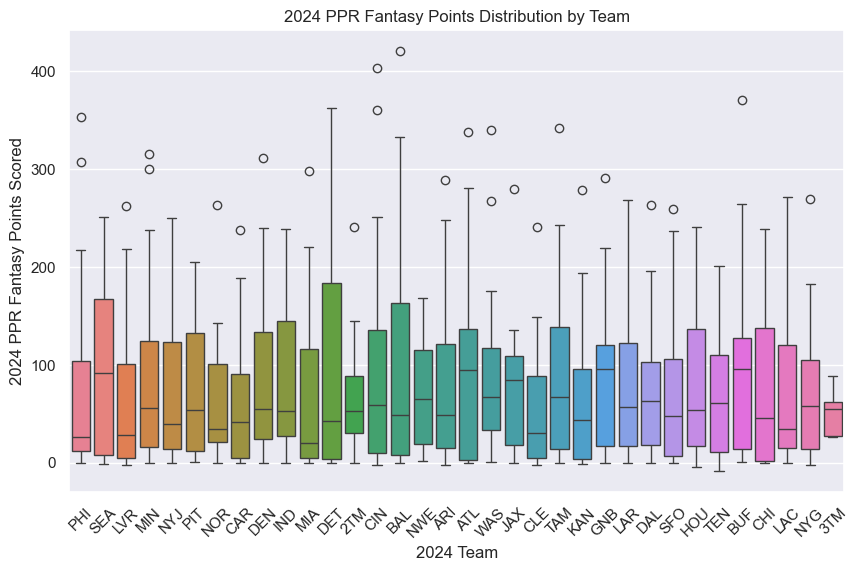

In [22]:
sns.boxplot(x="2024 Team", y='2024 PPR Fantasy Points Scored', data=df, hue='2024 Team', legend=False)
plt.title("2024 PPR Fantasy Points Distribution by Team")
plt.xticks(rotation=45)
plt.show()

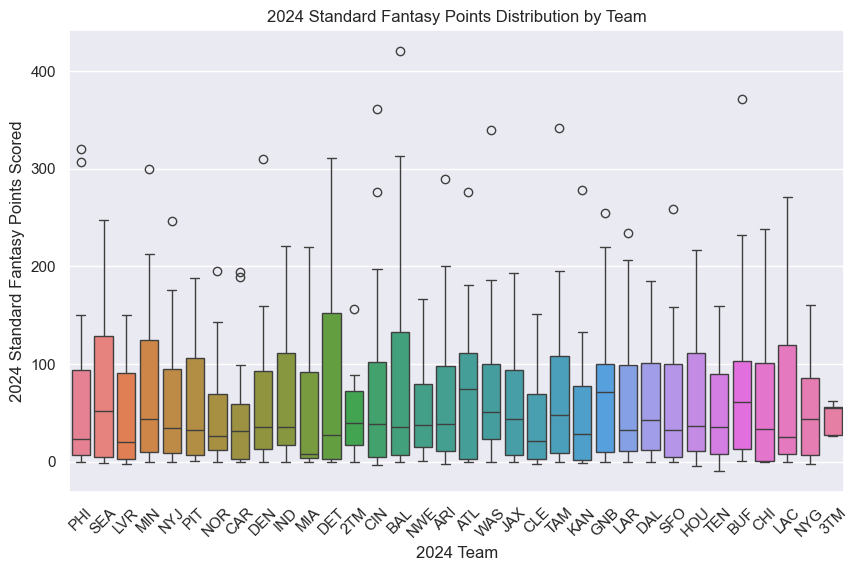

In [29]:
sns.boxplot(x="2024 Team", y='2024 Standard Fantasy Points Scored', data=df, hue='2024 Team', legend=False)
plt.title("2024 Standard Fantasy Points Distribution by Team")
plt.xticks(rotation=45)
plt.show()

## Scatterplots

In [35]:
def fantasy_feature_scatterplot(feature1, feature2):
    plt.figure(figsize=(8, 6))

    years = ["2022", "2023", "2024"]
    colors = ["darkblue", "seagreen", "sienna"]
    markers = ["o", "s", "^"]

    for year, color, marker in zip(years, colors, markers):
        sns.scatterplot(
            x=df[f"{year} {feature1}"],
            y=df[f"{year} {feature2}"],
            label=year,
            color=color,
            marker=marker
        )

    plt.title(f"{feature1} vs {feature2}")
    plt.xlabel(f"{feature1}")
    plt.ylabel(f"{feature2}")
    plt.legend(title="Year")
    plt.show()

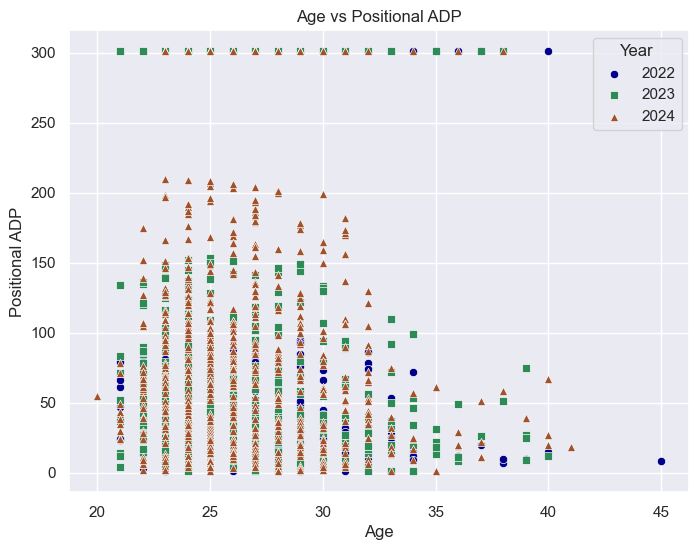

In [36]:
fantasy_feature_scatterplot("Age", "Positional ADP")

I wonder who that blue dot from 2022 in the lower right corner is.

In [61]:
def fantasy_feature_scatterplotter(feature1, feature2, save=False):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=False)

    years = ["2022", "2023", "2024"]
    colors = ["darkblue", "seagreen", "sienna"]

    for ax, year, color in zip(axes, years, colors):
        sns.scatterplot(
           x=df[f"{year} {feature1}"],  
            y=df[f"{year} {feature2}"],  
            color=color,
            ax=ax
        )
        ax.set_title(f"{year} {feature1} vs {feature2} Scatter Plot") # Rerun this to fix plot names
    
    plt.tight_layout()
    if save:
        plt.savefig(f'{feature1}_vs_{feature2}_scatter.png')
    plt.show()

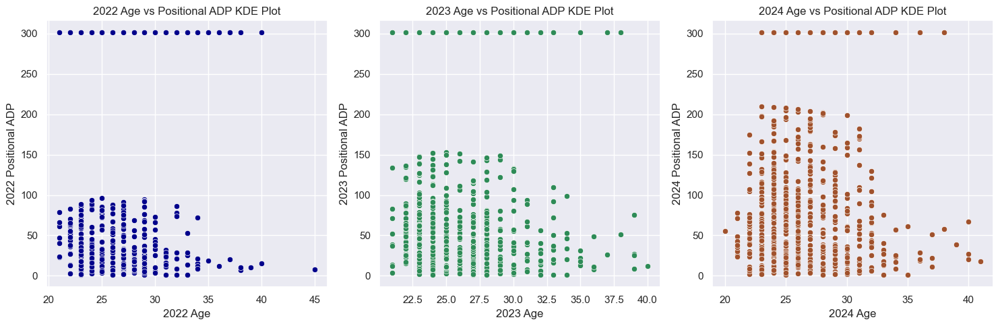

In [54]:
fantasy_feature_scatterplotter("Age", "Positional ADP")

### PPR

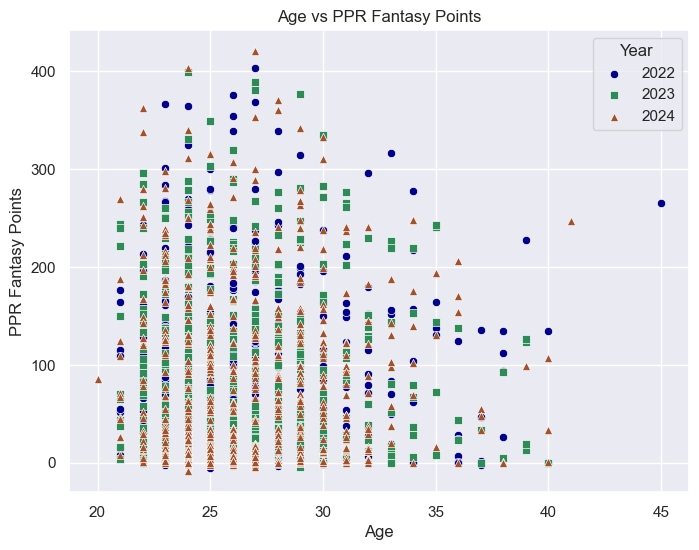

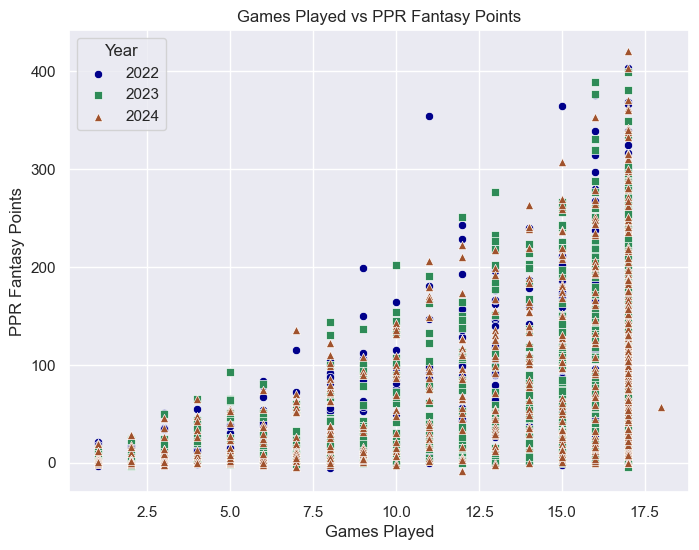

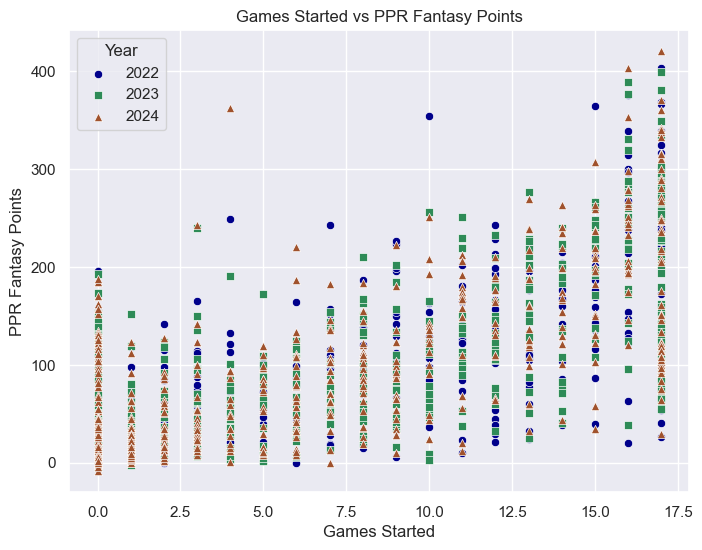

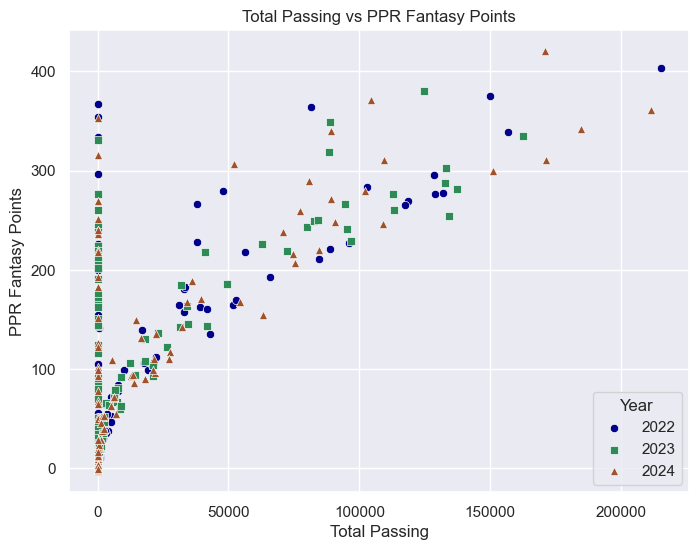

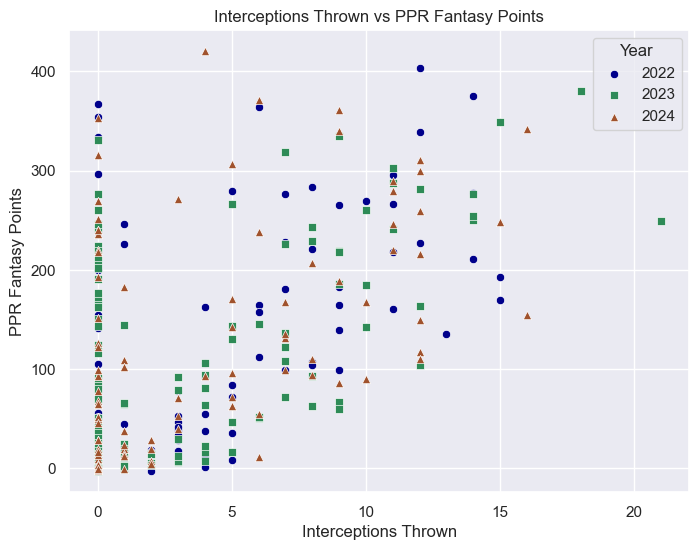

...

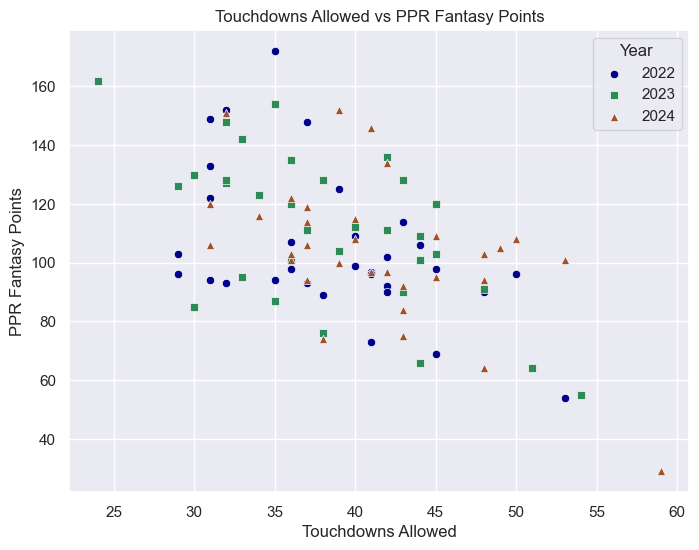

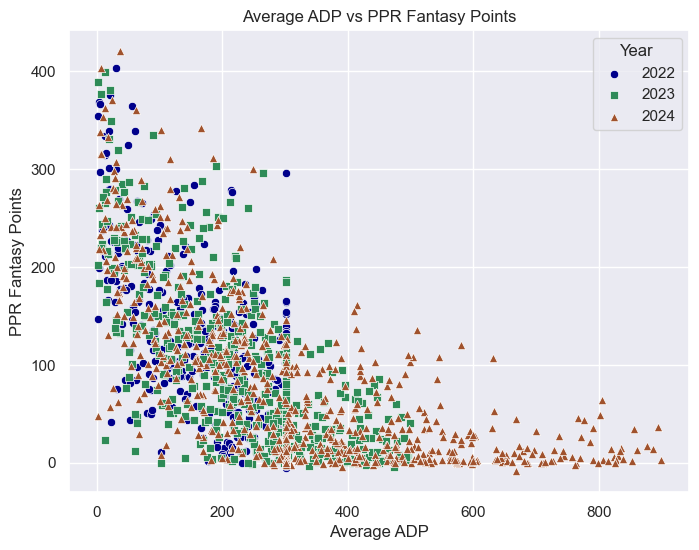

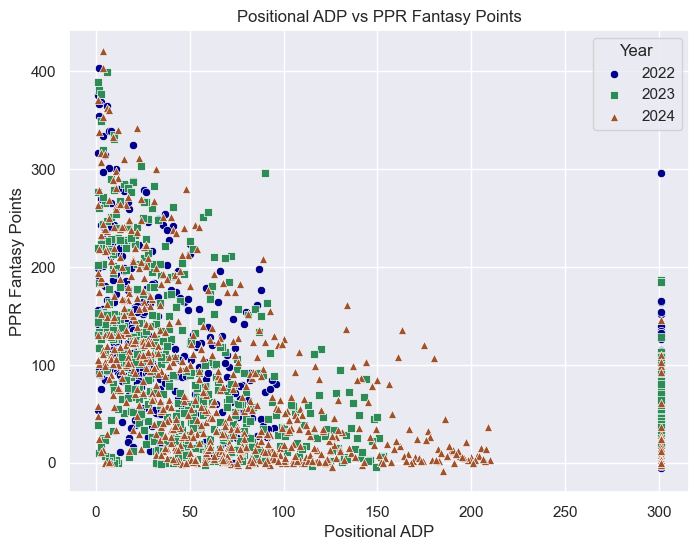

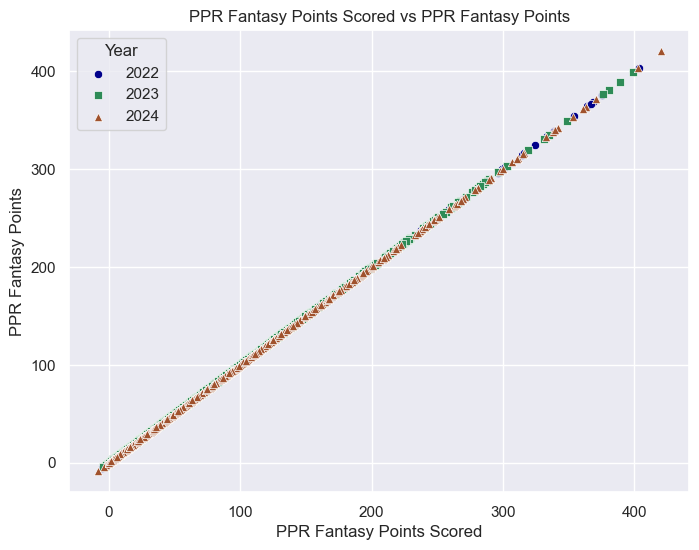

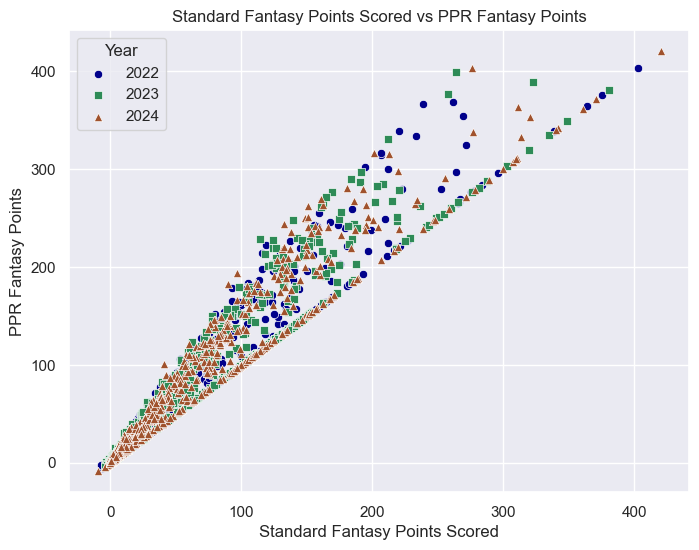

In [10]:
for f in feature_cols:
    fantasy_feature_scatterplot(feature=f, point_type="PPR")

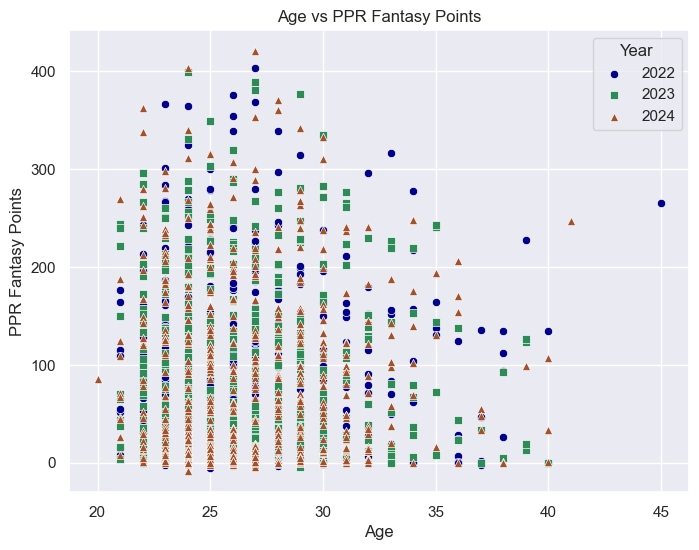

In [4]:
plt.figure(figsize=(8, 6))



years = ["2022", "2023", "2024"]
feature = "Age"
point_type = "PPR"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Age"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Age vs PPR Fantasy Points")
plt.xlabel("Age")
plt.ylabel("PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

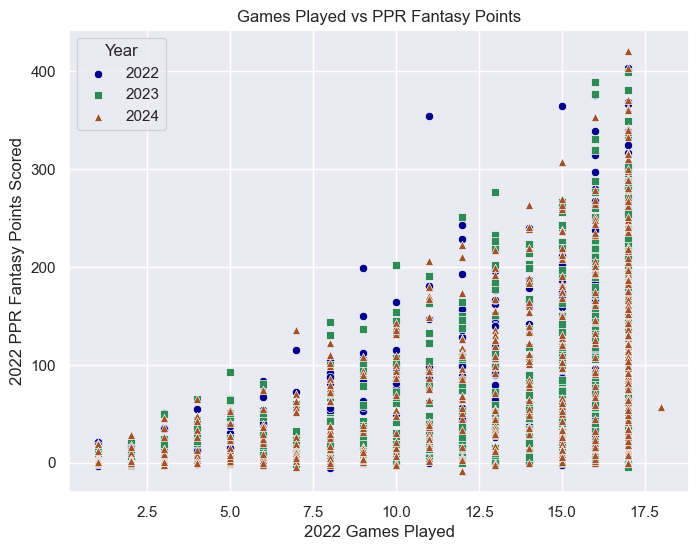

In [33]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Games Played"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Games Played vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

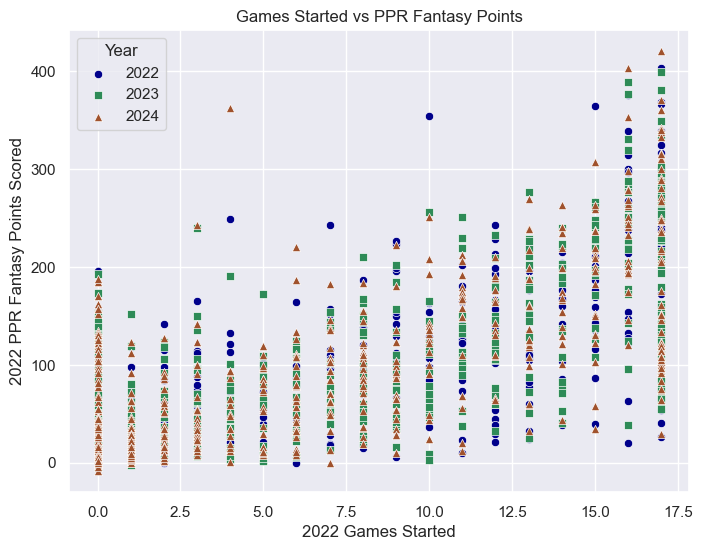

In [34]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Games Started"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Games Started vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

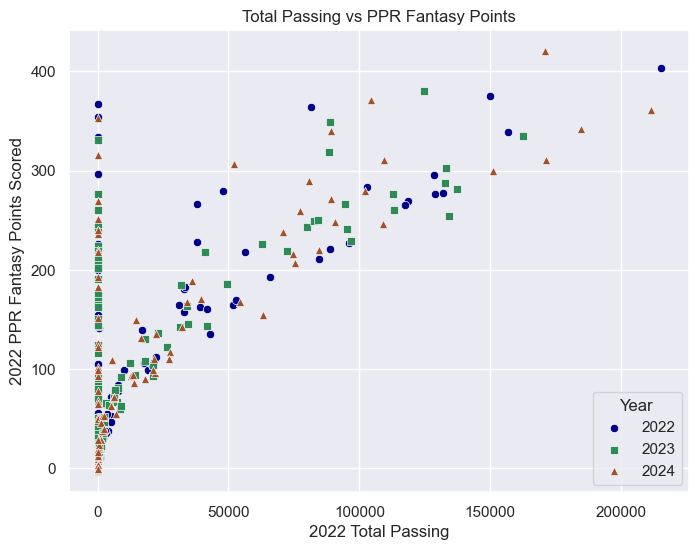

In [35]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Total Passing"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Total Passing vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

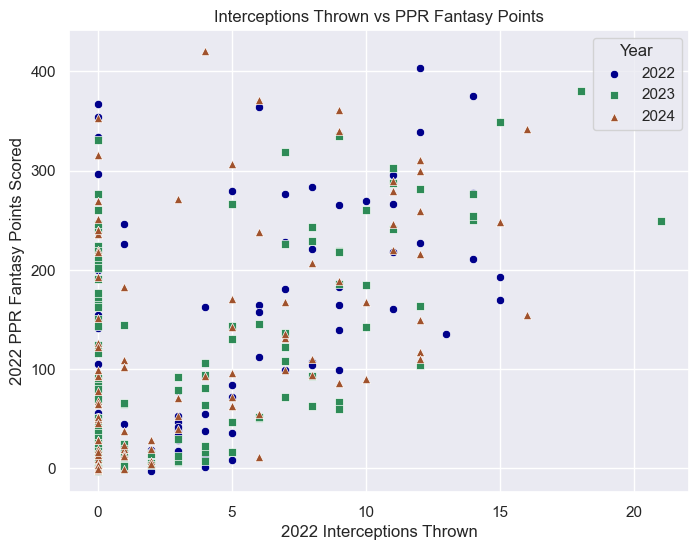

In [36]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Interceptions Thrown"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Interceptions Thrown vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

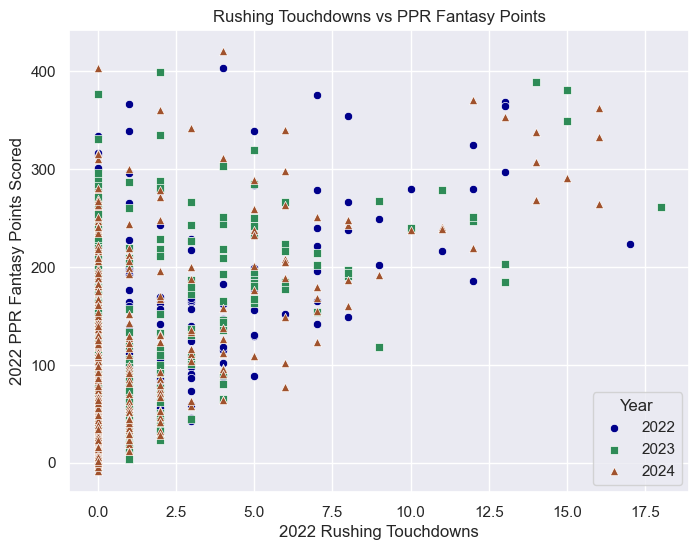

In [37]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Rushing Touchdowns"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Rushing Touchdowns vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

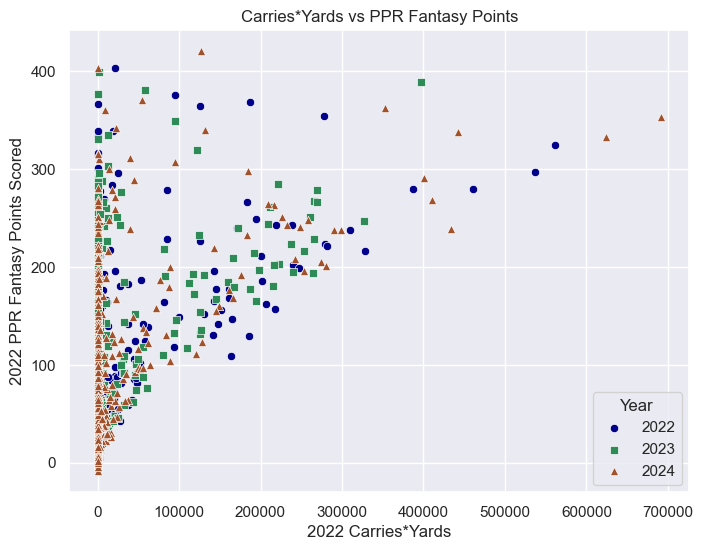

In [38]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Carries*Yards"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Carries*Yards vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

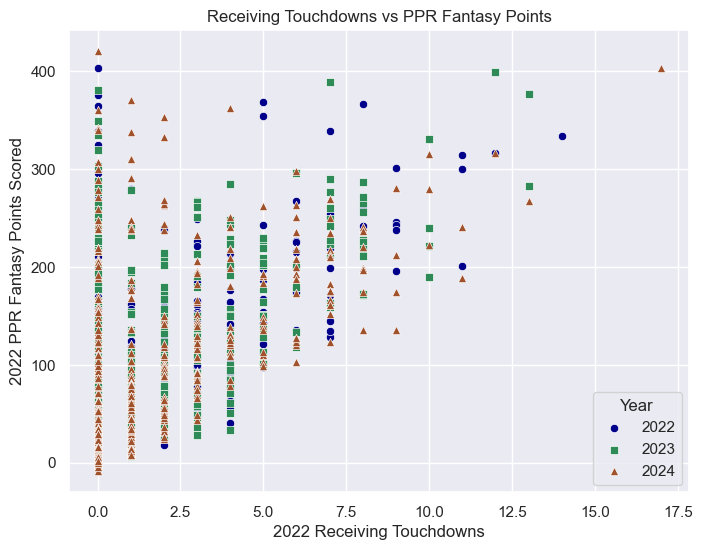

In [39]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Receiving Touchdowns"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Receiving Touchdowns vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

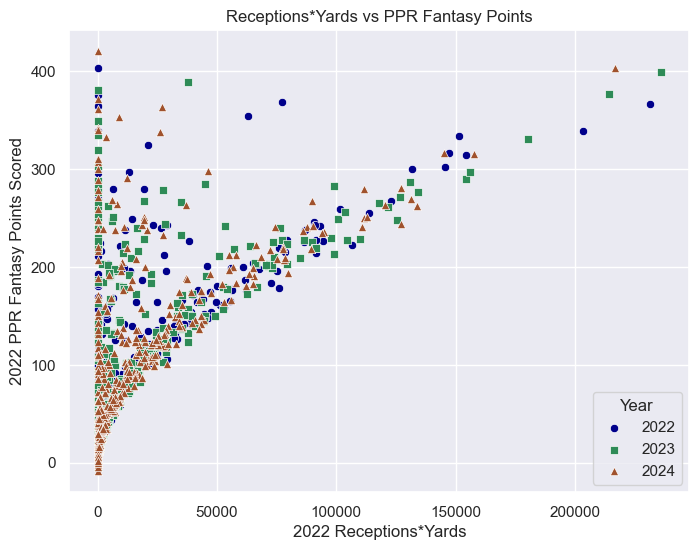

In [41]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Receptions*Yards"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Receptions*Yards vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

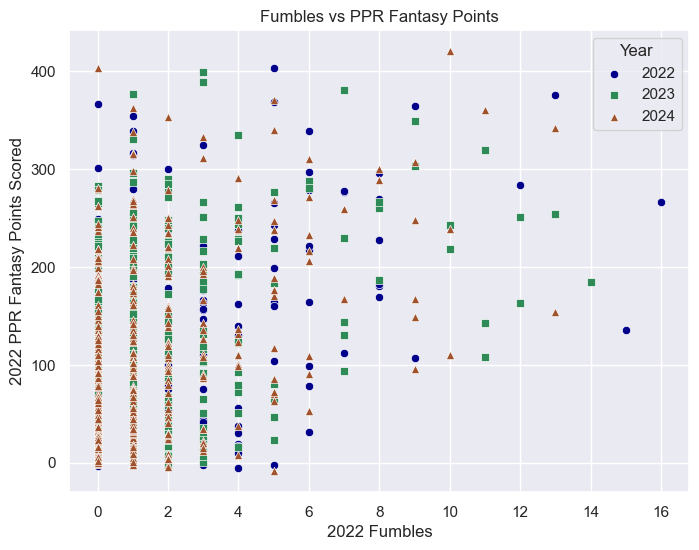

In [42]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Fumbles"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Fumbles vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

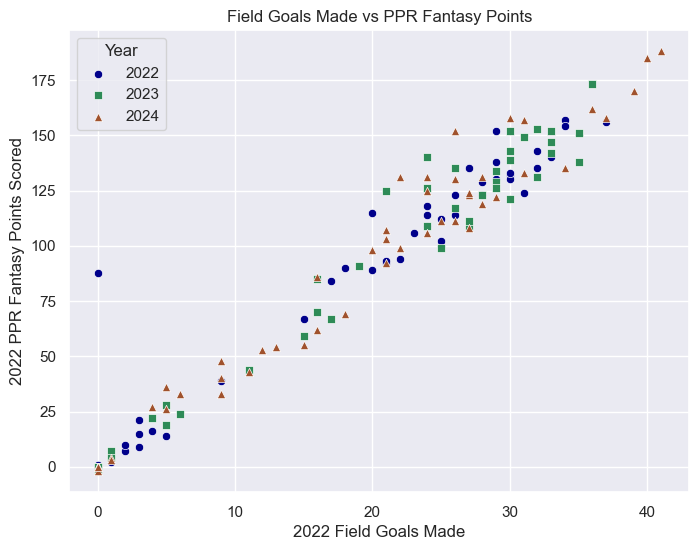

In [43]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Field Goals Made"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Field Goals Made vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

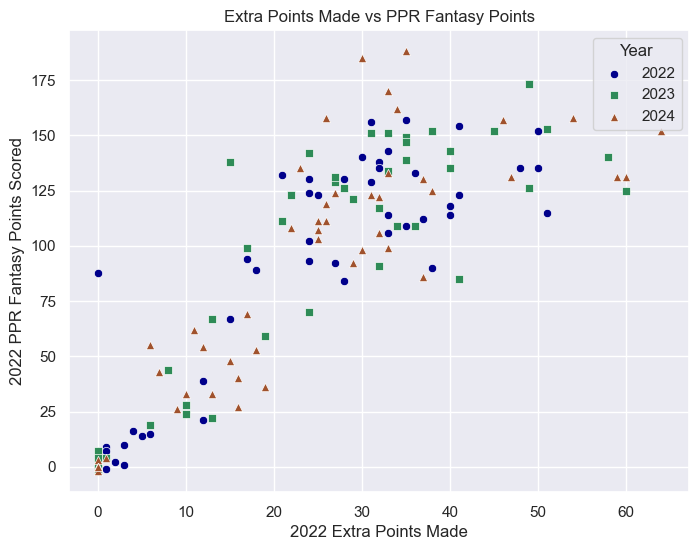

In [44]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Extra Points Made"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Extra Points Made vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

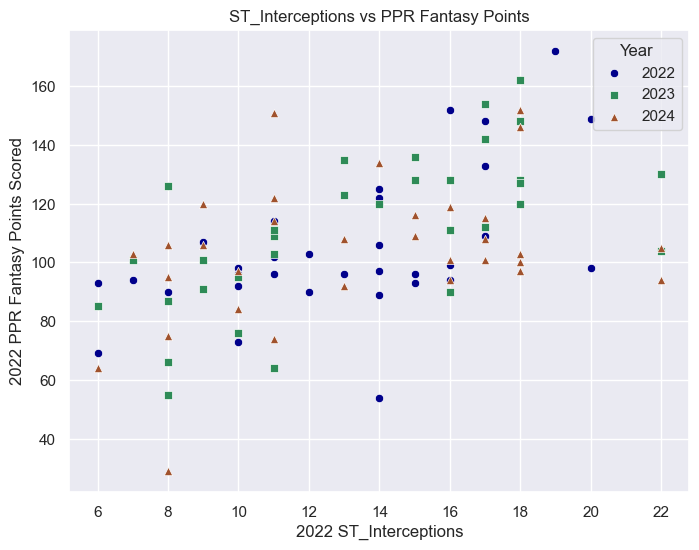

In [45]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} ST_Interceptions"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("ST_Interceptions vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

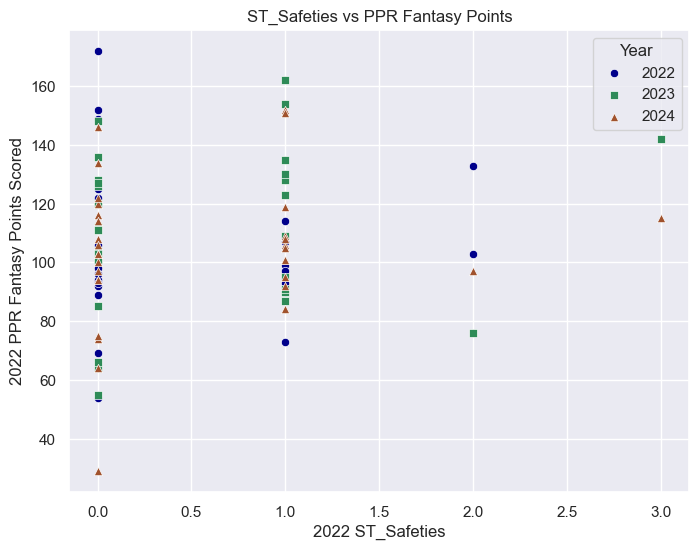

In [46]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} ST_Safeties"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("ST_Safeties vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

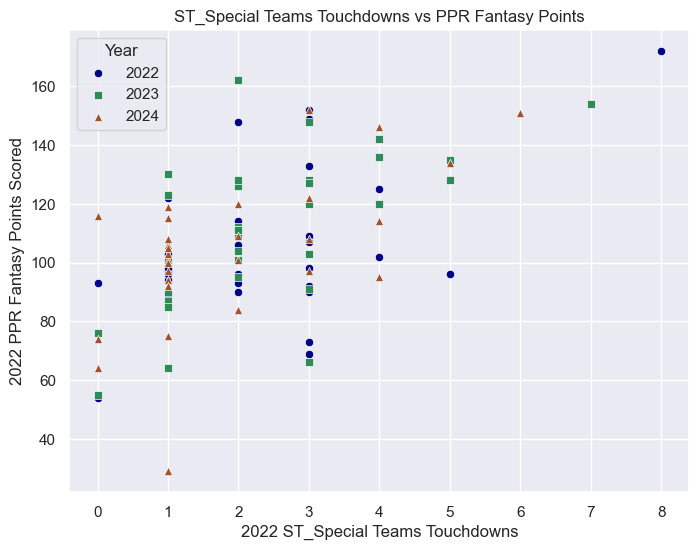

In [47]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} ST_Special Teams Touchdowns"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("ST_Special Teams Touchdowns vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

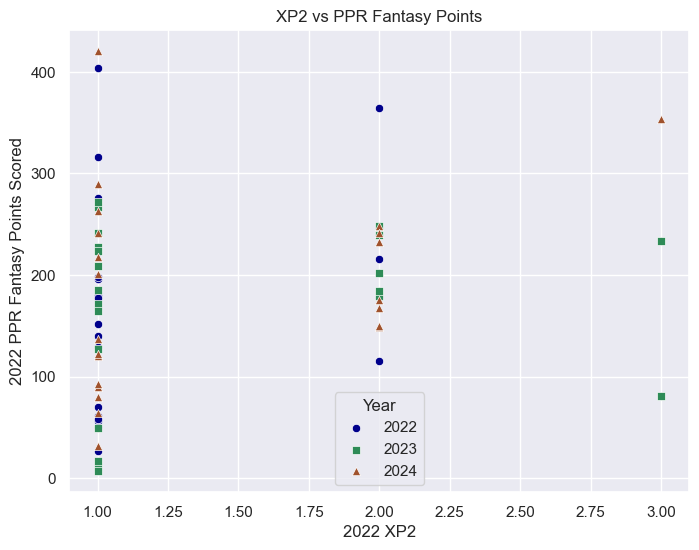

In [50]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} XP2"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("XP2 vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

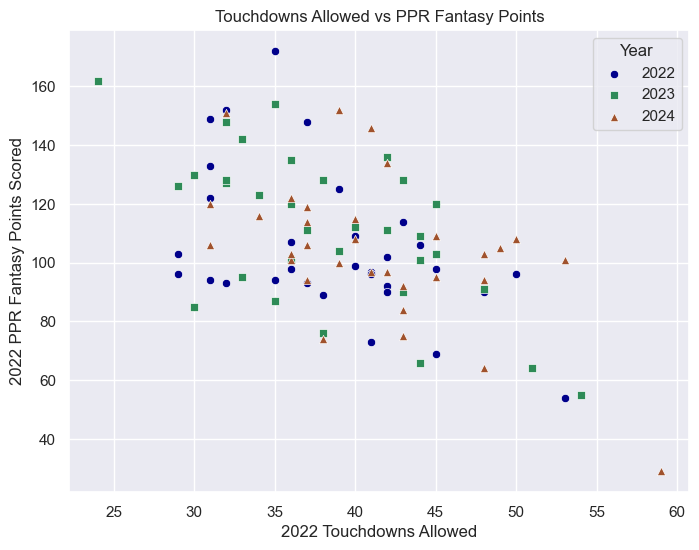

In [51]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Touchdowns Allowed"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Touchdowns Allowed vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

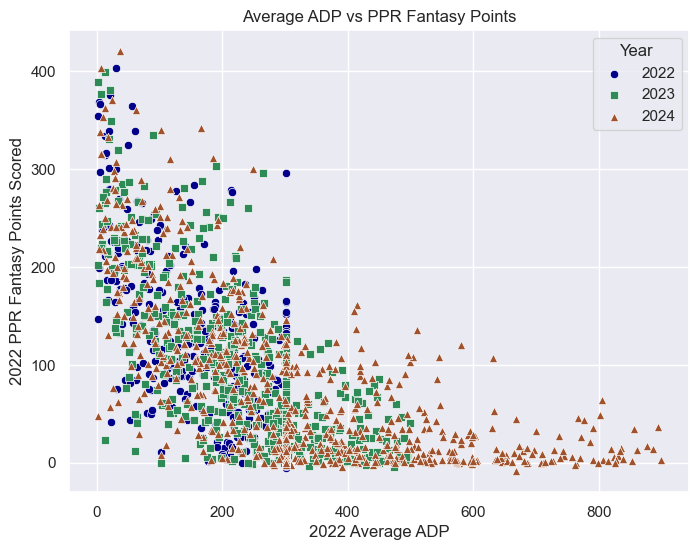

In [52]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Average ADP"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Average ADP vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

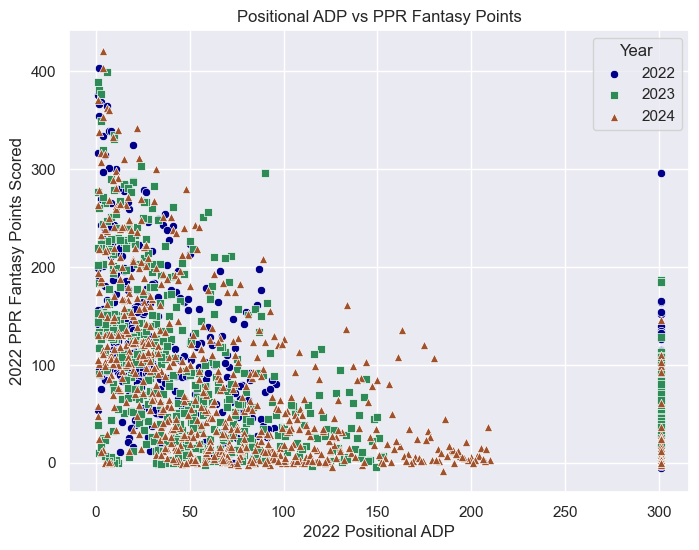

In [53]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Positional ADP"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Positional ADP vs PPR Fantasy Points")
plt.legend(title="Year")
plt.show()

### Standard

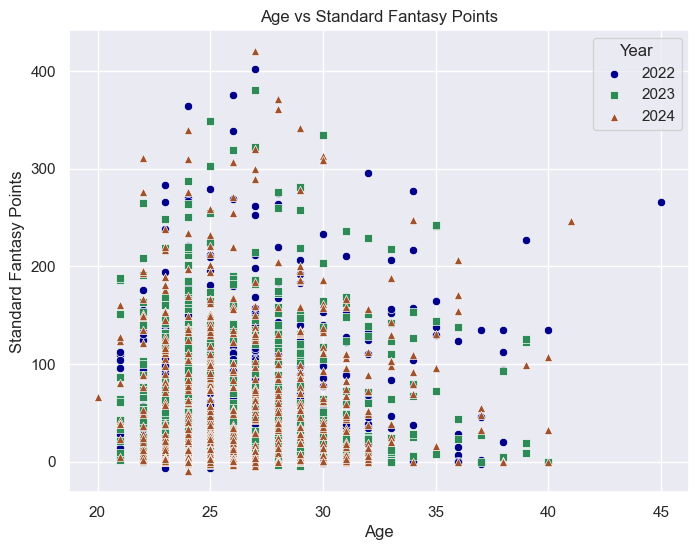

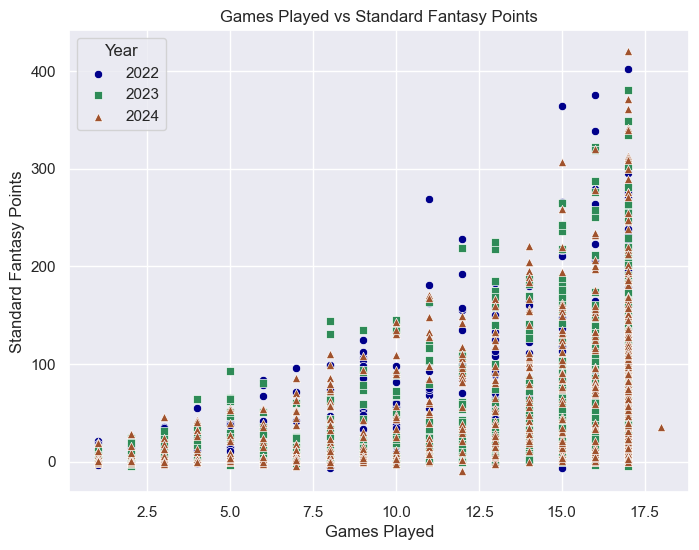

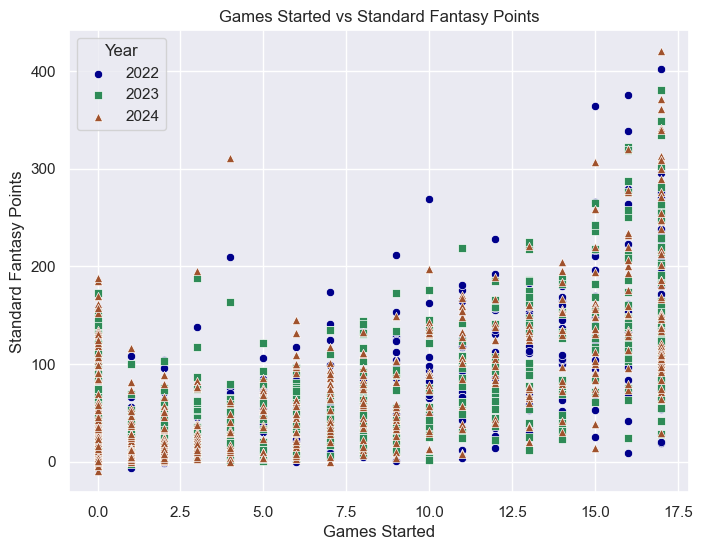

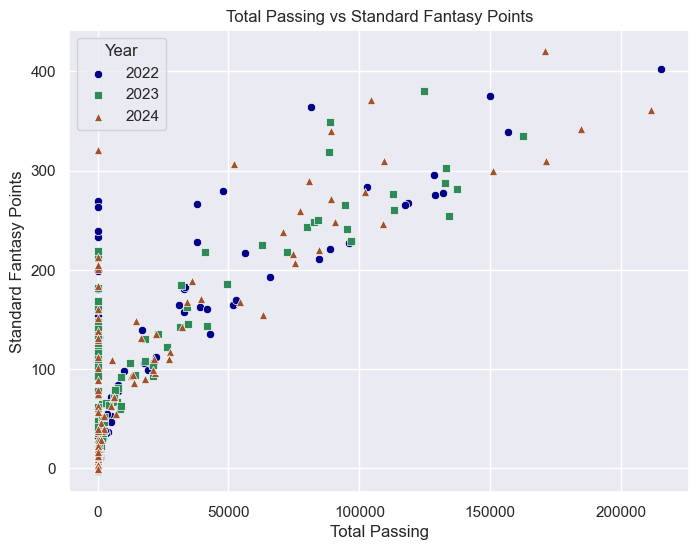

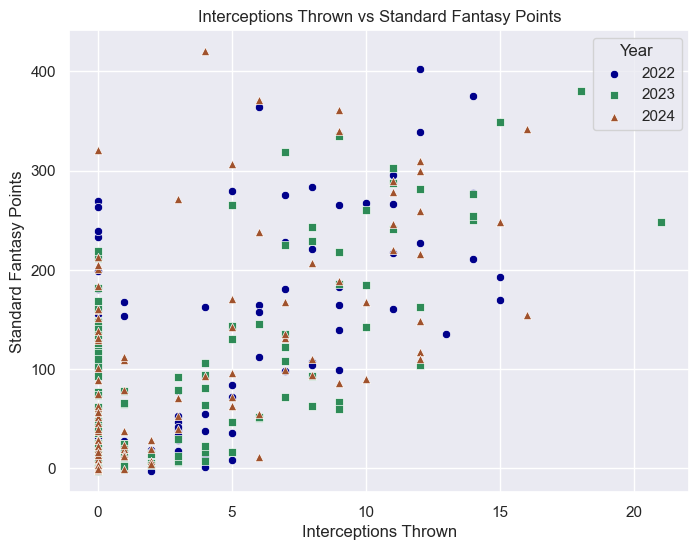

...

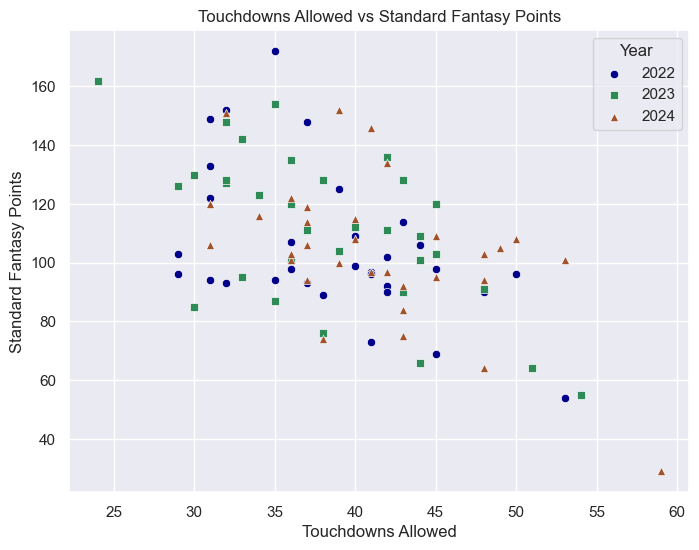

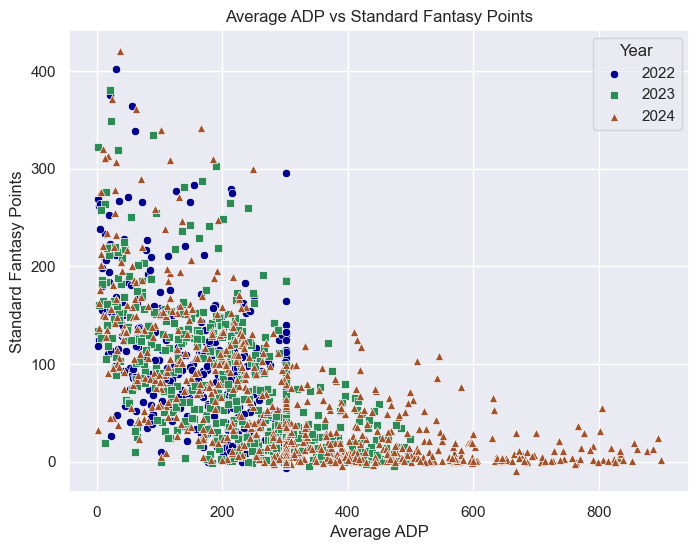

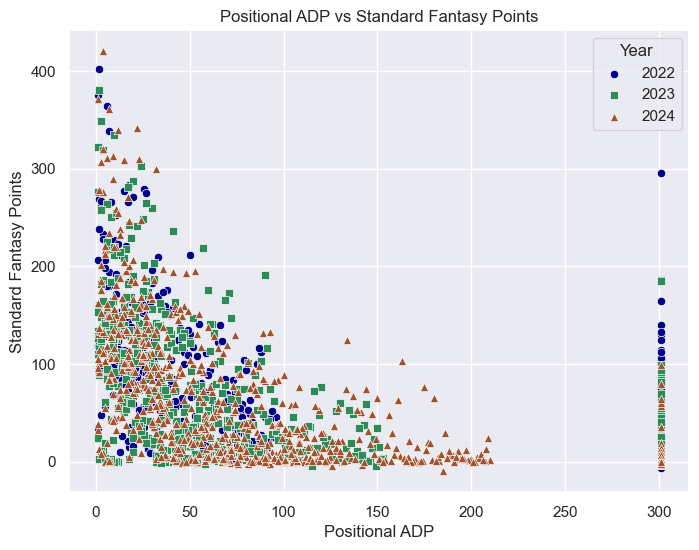

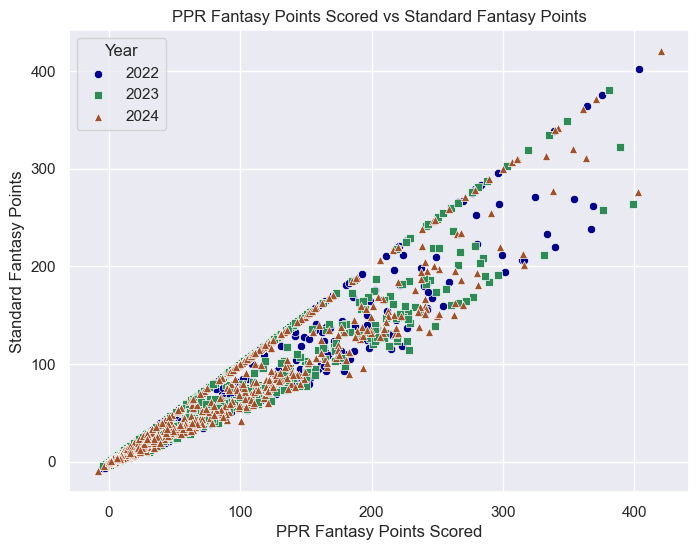

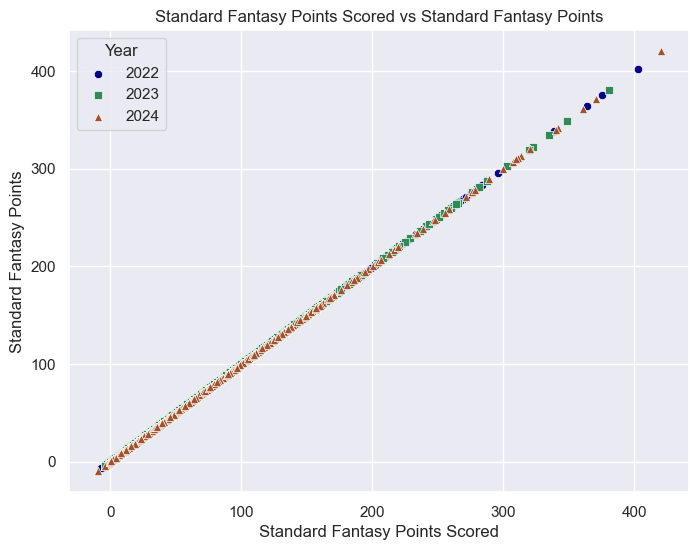

In [11]:
for f in feature_cols:
    fantasy_feature_scatterplot(feature=f, point_type="Standard")

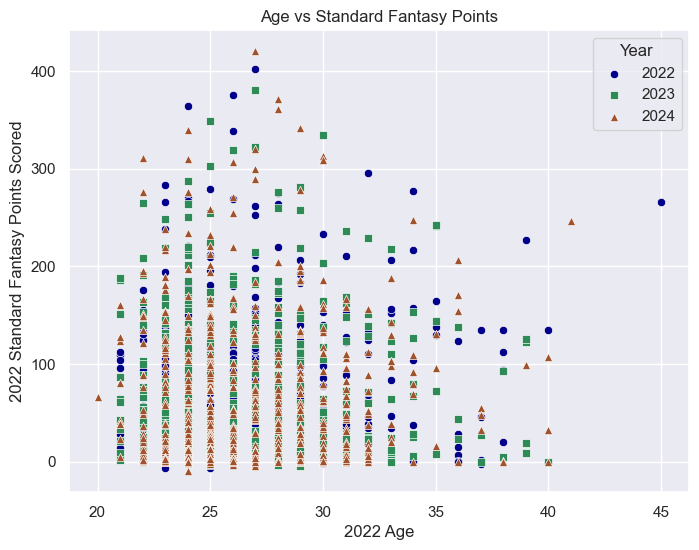

In [59]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Age"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Age vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

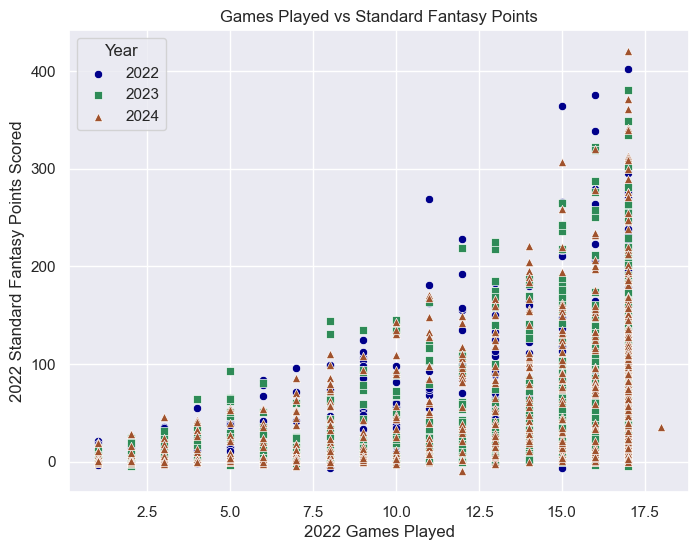

In [60]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} Games Played"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title("Games Played vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

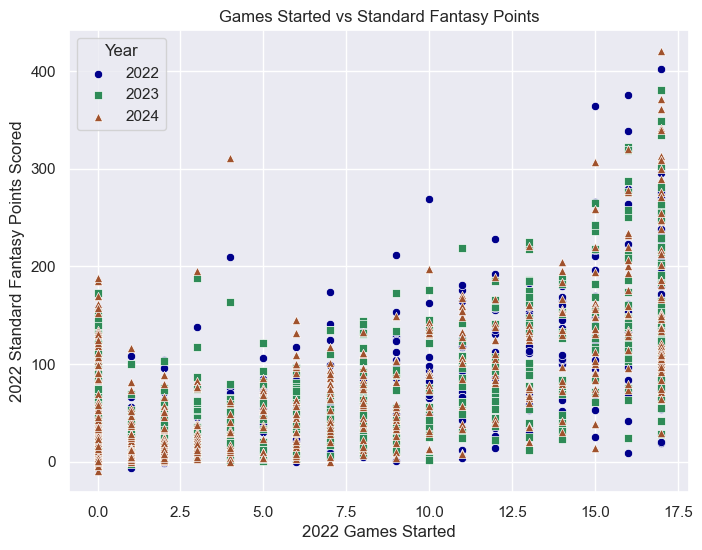

In [76]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Games Started"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

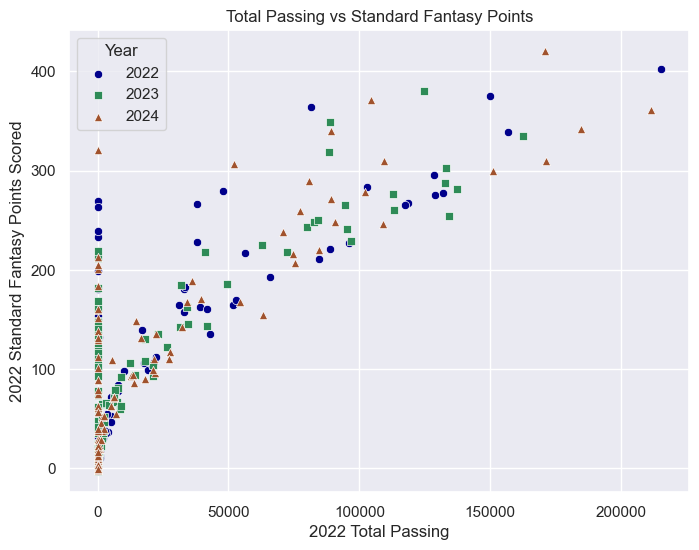

In [58]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Total Passing"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

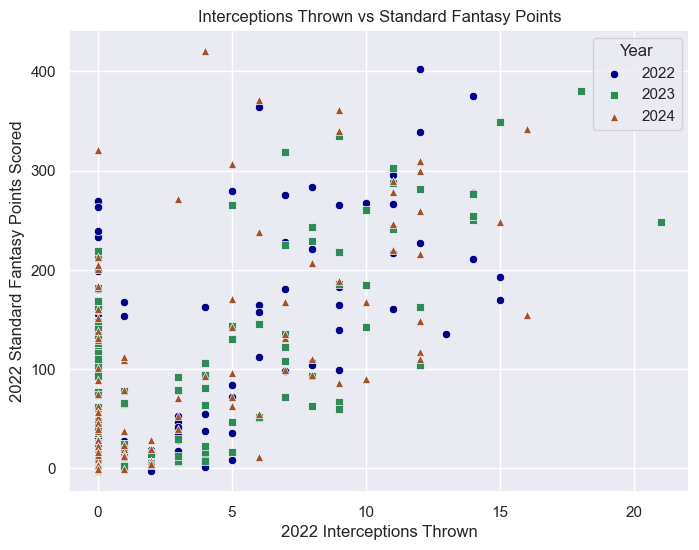

In [61]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Interceptions Thrown"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

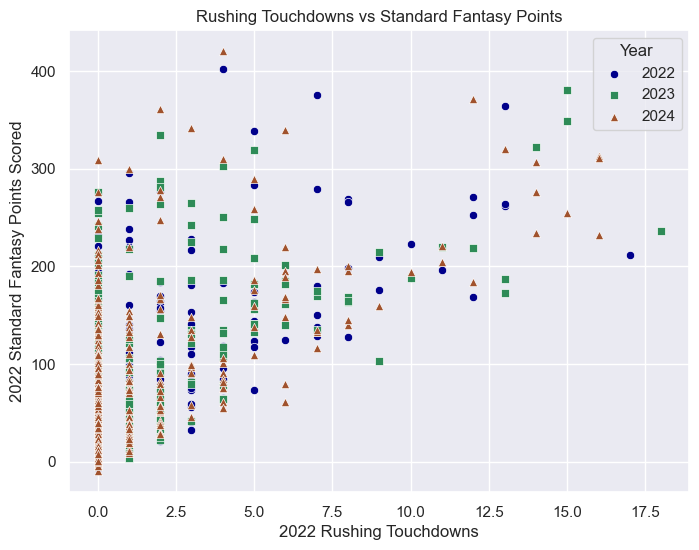

In [62]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Rushing Touchdowns"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

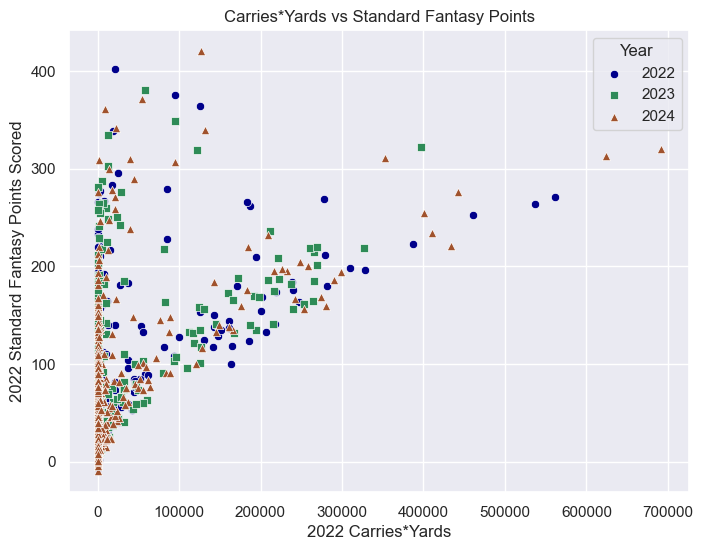

In [63]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Carries*Yards"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

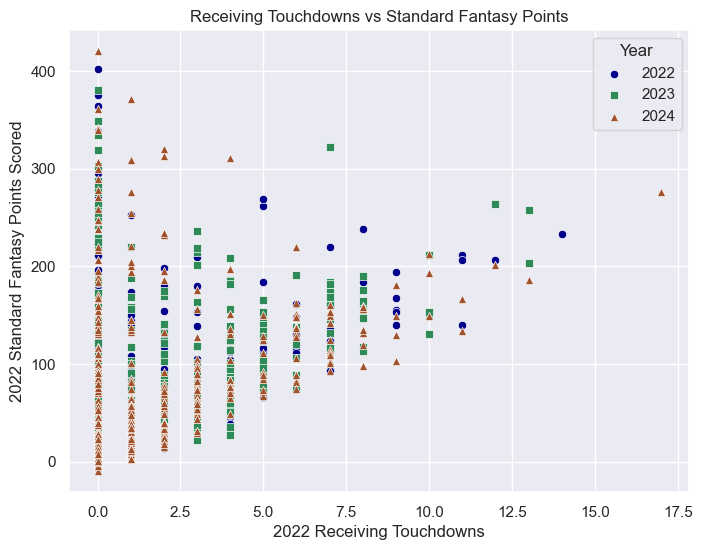

In [64]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Receiving Touchdowns"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

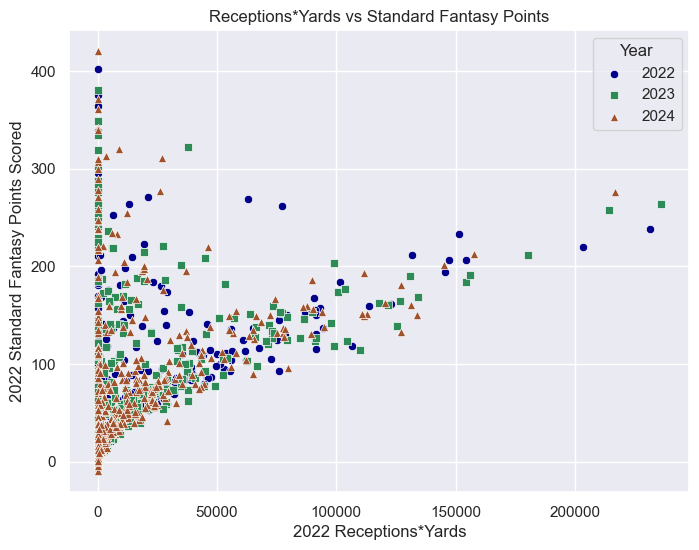

In [65]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Receptions*Yards"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

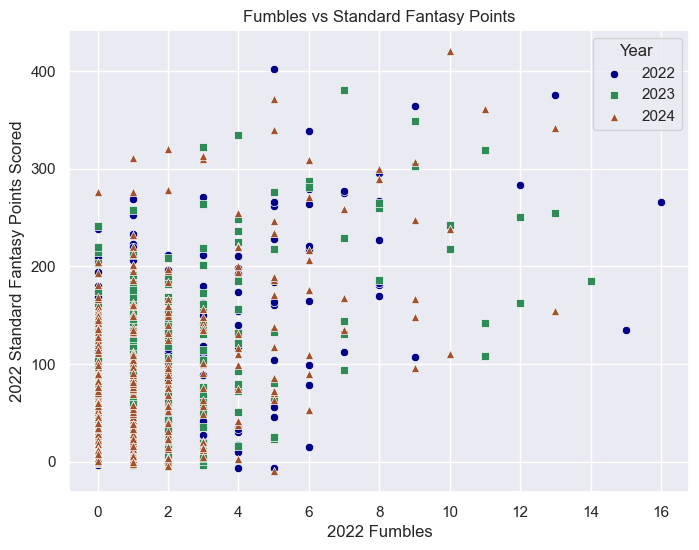

In [66]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Fumbles"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

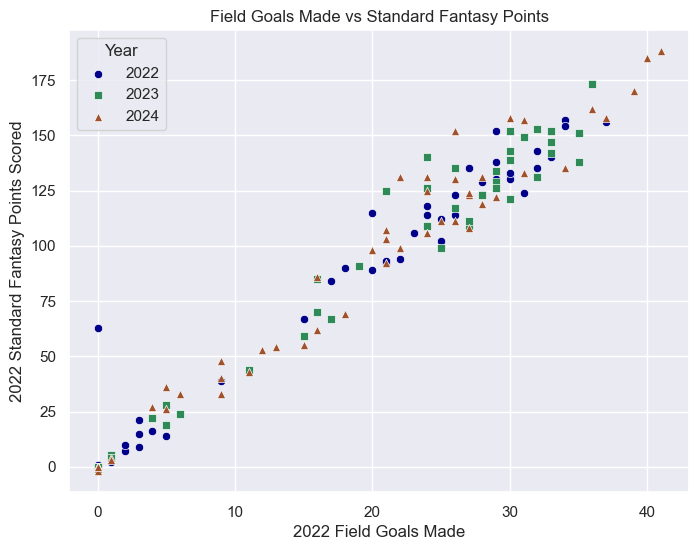

In [67]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Field Goals Made"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

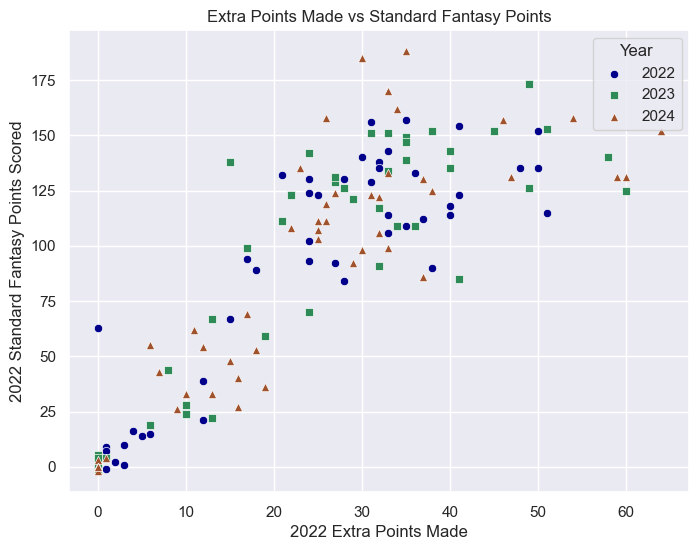

In [68]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Extra Points Made"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

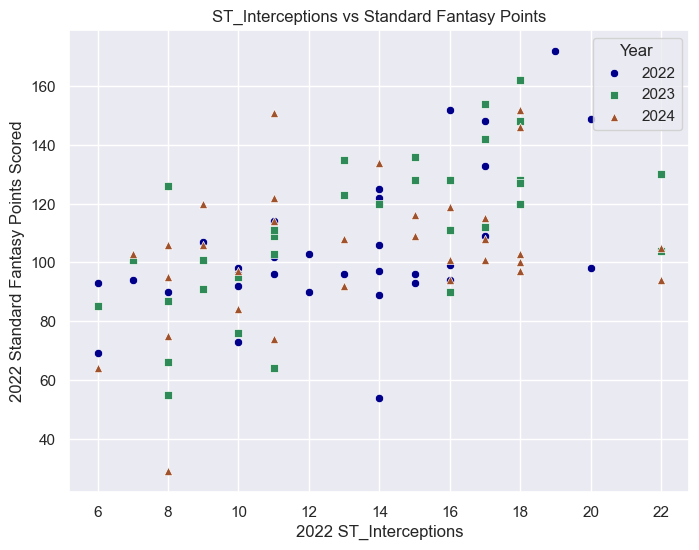

In [69]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "ST_Interceptions"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

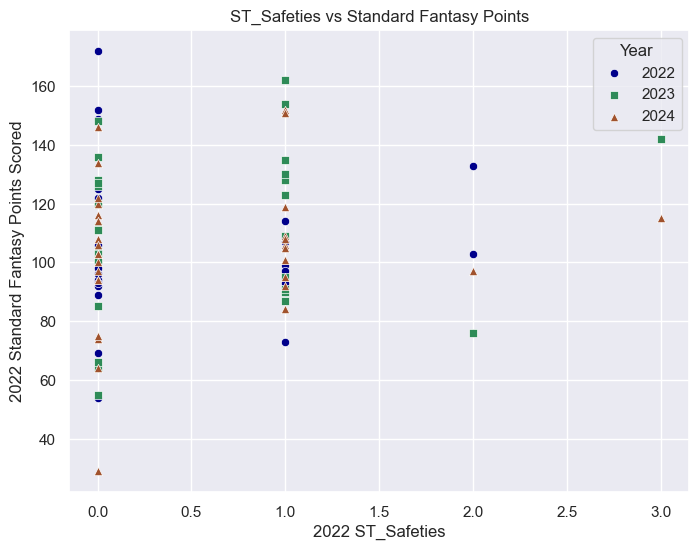

In [70]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "ST_Safeties"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

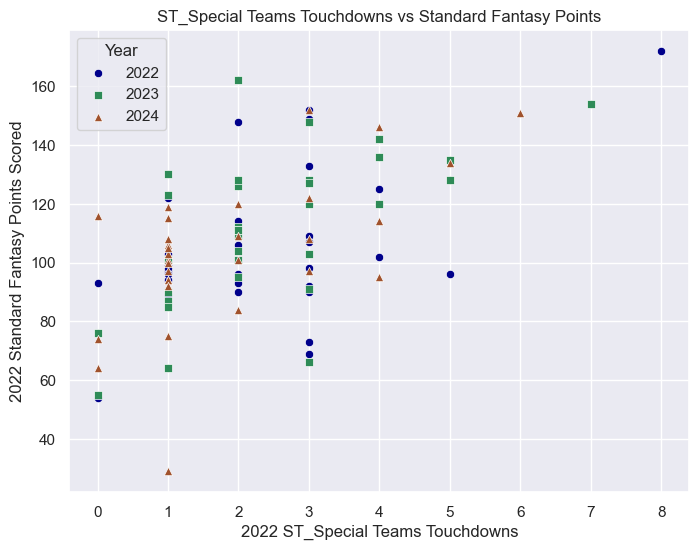

In [71]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "ST_Special Teams Touchdowns"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

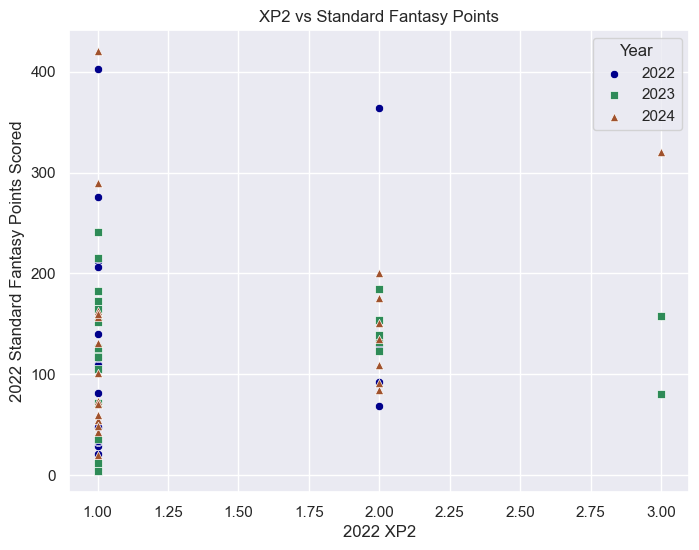

In [72]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "XP2"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

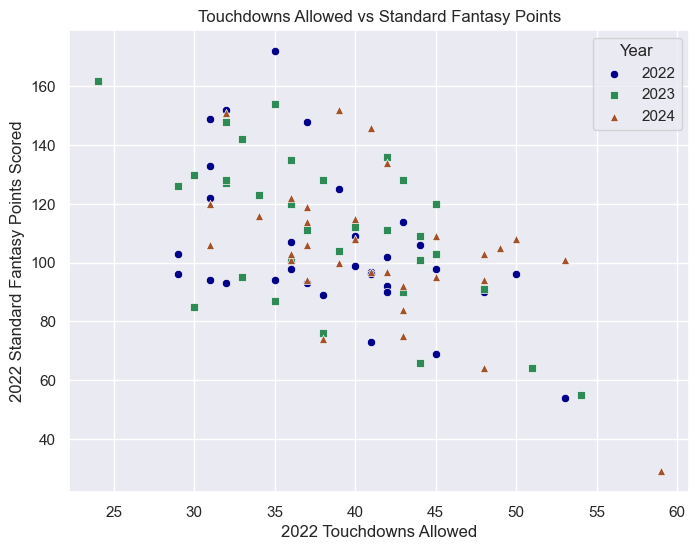

In [73]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Touchdowns Allowed"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

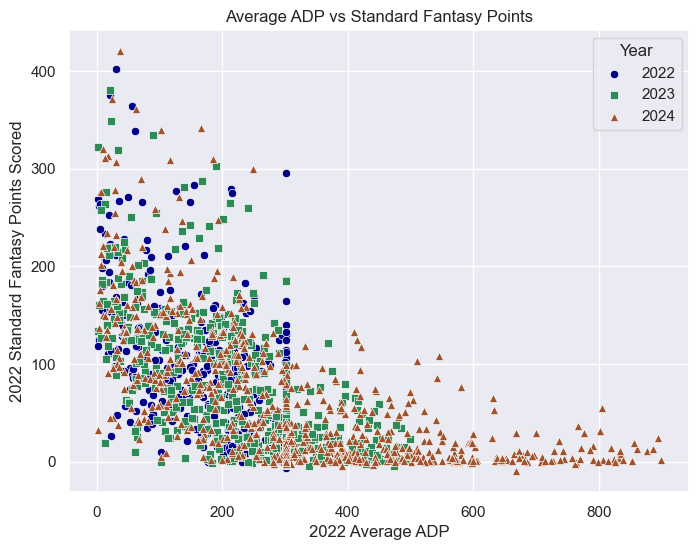

In [74]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Average ADP"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

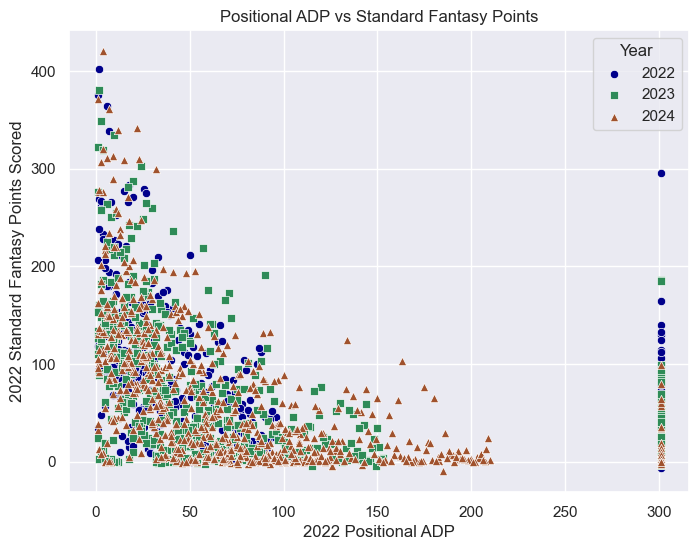

In [75]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
feature = "Positional ADP"
colors = ["darkblue", "seagreen", "sienna"]
markers = ["o", "s", "^"]

for year, color, marker in zip(years, colors, markers):
    sns.scatterplot(
        x=df[f"{year} {feature}"],
        y=df[f"{year} Standard Fantasy Points Scored"],
        label=year,
        color=color,
        marker=marker
    )

plt.title(f"{feature} vs Standard Fantasy Points")
plt.legend(title="Year")
plt.show()

## Density Plots

In [48]:
def fantasy_feature_kdeplot(feature, point_type, fill=False, alpha=1.0):
    plt.figure(figsize=(8, 6))


    feature = feature
    point_type = point_type
    years = ["2022", "2023", "2024"]
    colors = ["darkblue", "seagreen", "sienna"]
    legend_handles = []

    for year, color in zip(years, colors):
        sns.kdeplot(
            x=df[f"{year} {feature}"],
            y=df[f"{year} {point_type} Fantasy Points Scored"],
            color=color,
            fill=fill,
            alpha=alpha,
            label=year
        )
        legend_handles.append(plt.Line2D([0], [0], color=color, lw=4, label=year))

    plt.title(f"{feature} vs {point_type} Fantasy Points")
    plt.xlabel(f"{feature}")
    plt.ylabel(f"{point_type} Fantasy Points")
    plt.legend(handles=legend_handles, title="Year")
    plt.show()

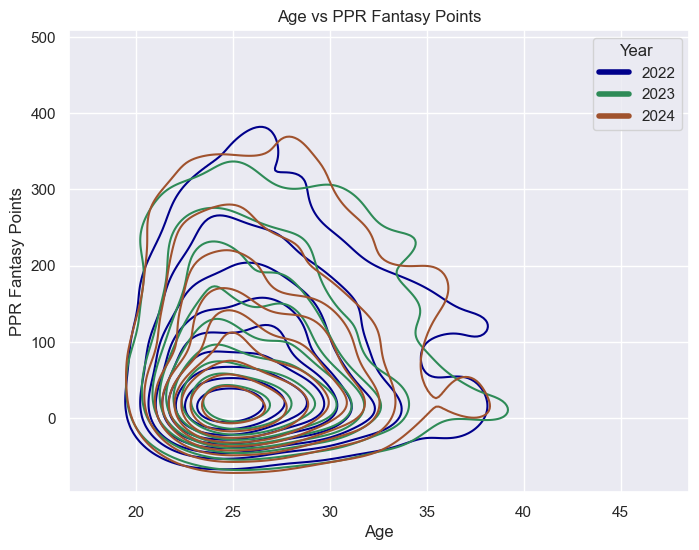

In [49]:
fantasy_feature_kdeplot("Age", "PPR")

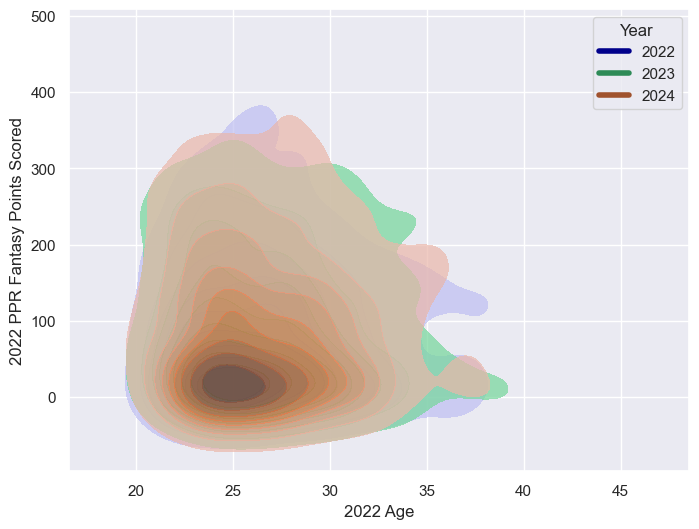

In [47]:
plt.figure(figsize=(8, 6))

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]
legend_handles = []


for year, color in zip(years, colors):
    sns.kdeplot(
        x=df[f"{year} Age"],
        y=df[f"{year} PPR Fantasy Points Scored"],
        color=color,
        fill=True,
        alpha=0.7,
        label=str(year)
    )
    legend_handles.append(plt.Line2D([0], [0], color=color, lw=4, label=year))
    
plt.legend(handles=legend_handles, title="Year")
plt.show()

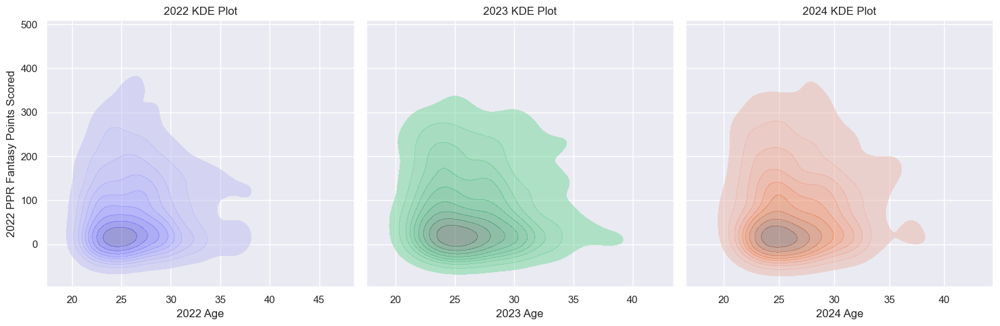

In [51]:
fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

years = ["2022", "2023", "2024"]
colors = ["darkblue", "seagreen", "sienna"]

for ax, year, color in zip(axes, years, colors):
    sns.kdeplot(
        x=df[f"{year} Age"],  
        y=df[f"{year} PPR Fantasy Points Scored"],  
        fill=True,
        color=color,
        alpha=0.5,
        ax=ax
    )
    ax.set_title(f"{year} KDE Plot")

plt.tight_layout()
plt.show()

In [56]:
def fantasy_feature_kdeplot_horiz(feature, point_type, fill=False, alpha=1.0):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=True)

    years = ["2022", "2023", "2024"]
    colors = ["darkblue", "seagreen", "sienna"]

    for ax, year, color in zip(axes, years, colors):
        sns.kdeplot(
           x=df[f"{year} {feature}"],  
            y=df[f"{year} {point_type} Fantasy Points Scored"],  
            fill=fill,
            color=color,
            alpha=alpha,
            ax=ax
        )
        ax.set_title(f"{year} {feature} KDE Plot")

    plt.tight_layout()
    plt.show()

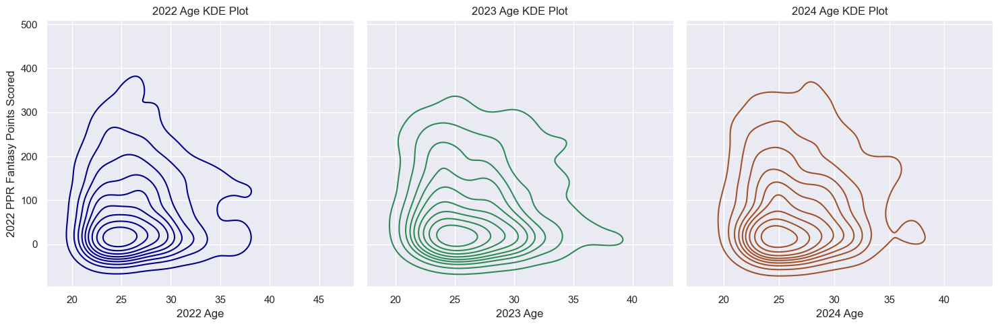

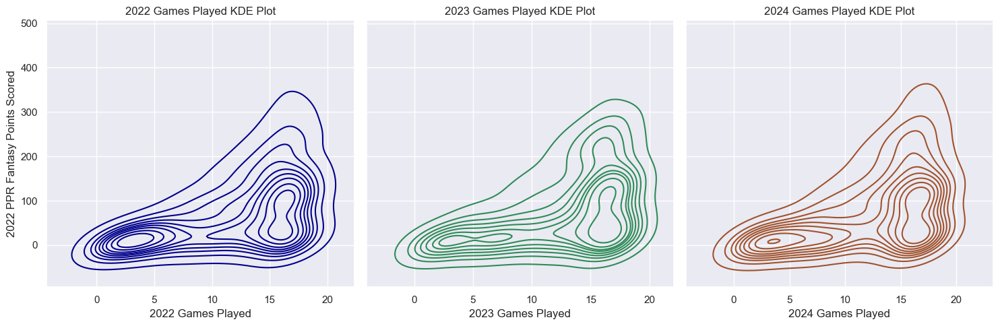

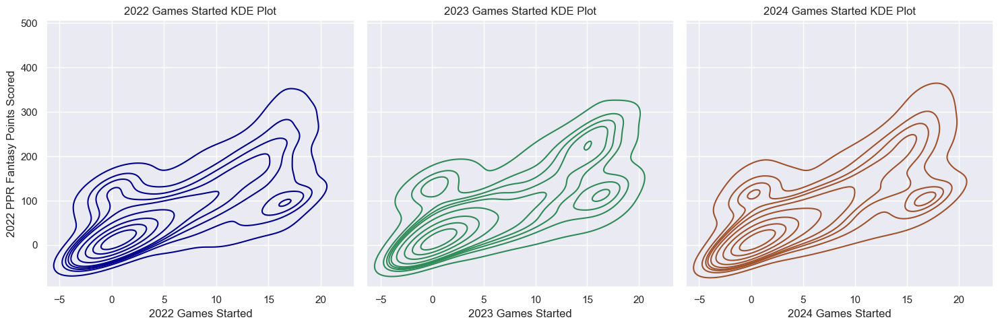

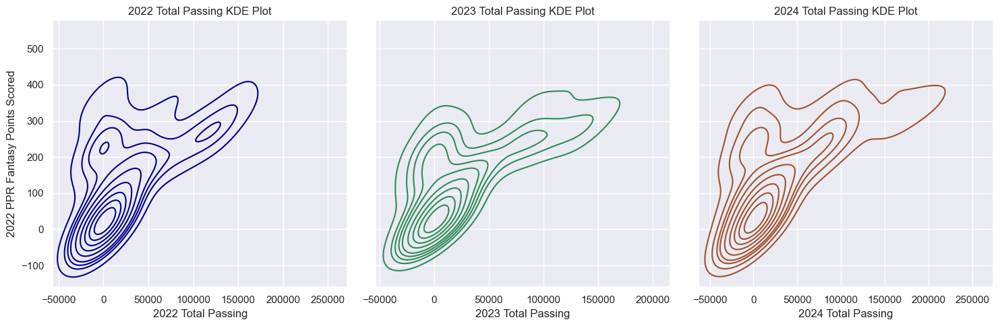

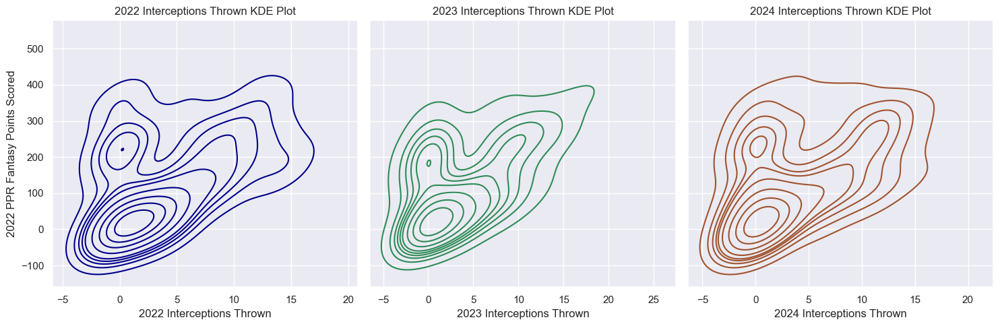

...

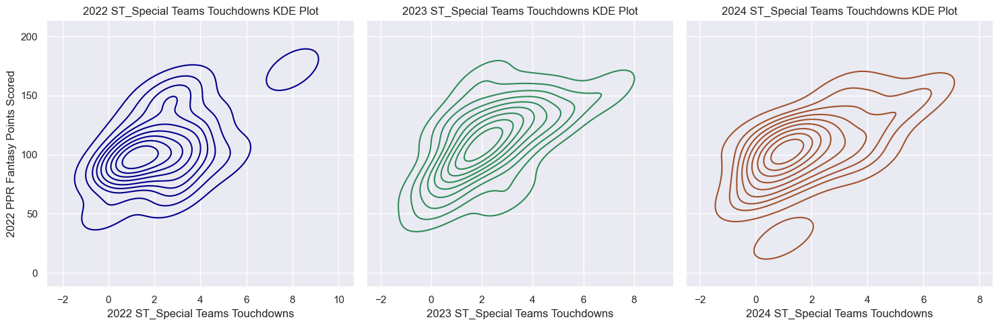

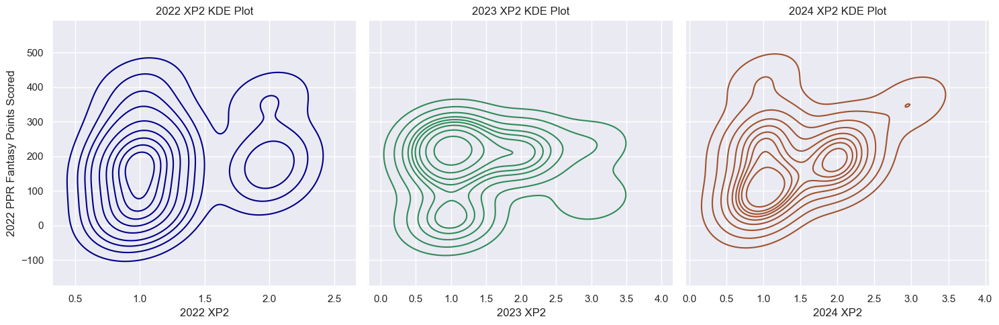

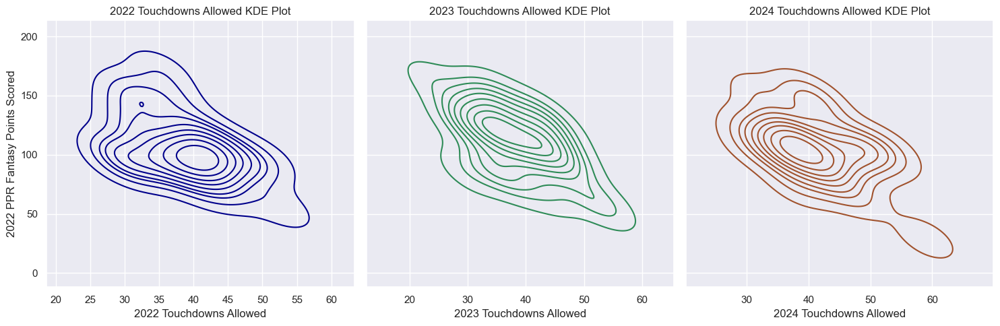

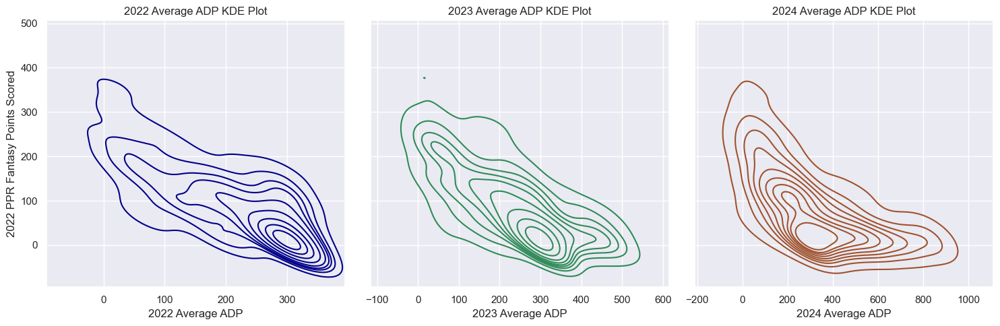

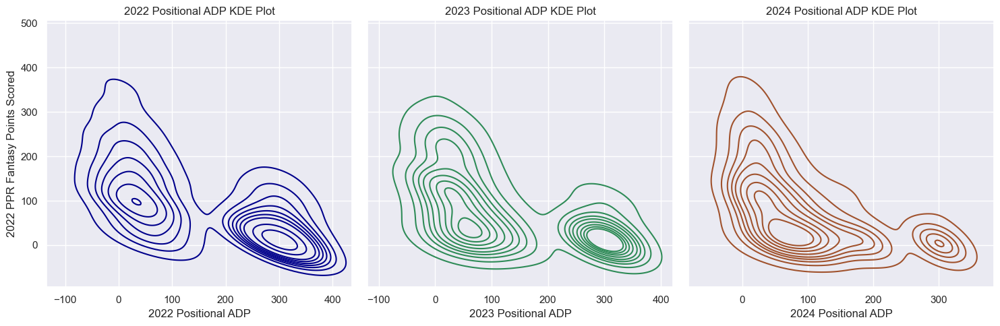

C:\Users\dblan\AppData\Local\Temp\ipykernel_411768\2975268759.py:8: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(
C:\Users\dblan\AppData\Local\Temp\ipykernel_411768\2975268759.py:8: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(
C:\Users\dblan\AppData\Local\Temp\ipykernel_411768\2975268759.py:8: UserWarning: KDE cannot be estimated (0 variance or perfect covariance). Pass `warn_singular=False` to disable this warning.
  sns.kdeplot(


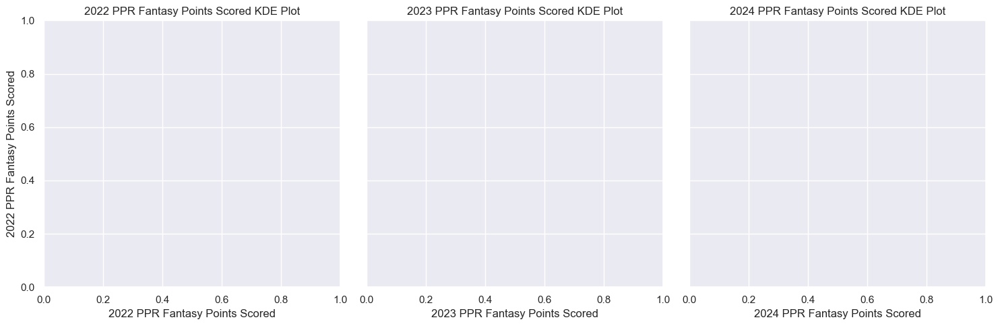

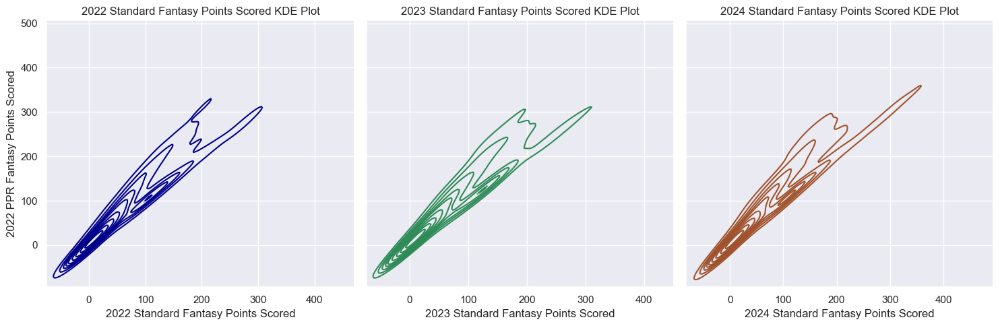

In [57]:
for f in feature_cols:
    fantasy_feature_kdeplot_horiz(f, "PPR",)

In [59]:
def fantasy_feature_kdeplotter(feature1, feature2, fill=False, alpha=1.0, save=False):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=False)

    years = ["2022", "2023", "2024"]
    colors = ["darkblue", "seagreen", "sienna"]

    for ax, year, color in zip(axes, years, colors):
        sns.kdeplot(
           x=df[f"{year} {feature1}"],  
            y=df[f"{year} {feature2}"],  
            fill=fill,
            color=color,
            alpha=alpha,
            ax=ax
        )
        ax.set_title(f"{year} {feature1} vs {feature2} KDE Plot")
    
    plt.tight_layout()
    if save:
        plt.savefig(f'{feature1}_vs_{feature2}_kde.png')
    plt.show()

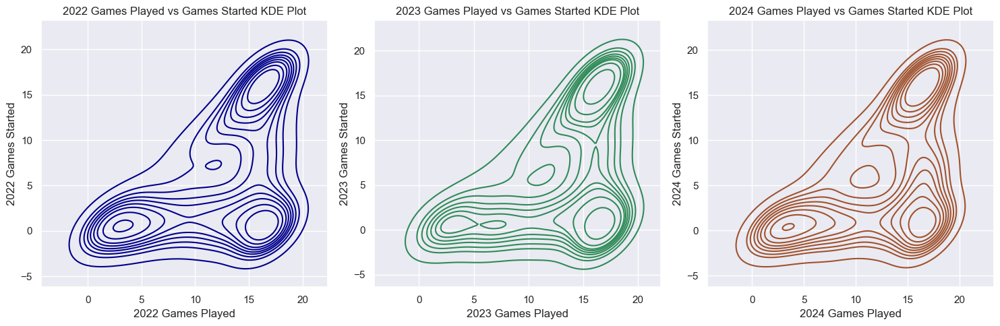

In [60]:
fantasy_feature_kdeplotter("Games Played", "Games Started", save=True)

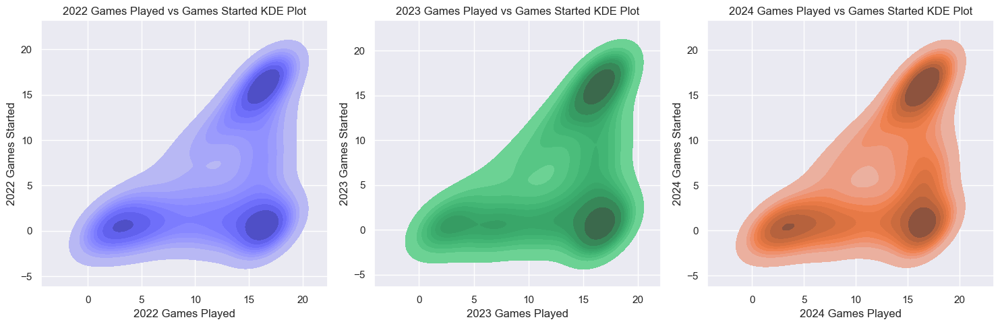

In [98]:
fantasy_feature_kdeplotter("Games Played", "Games Started", fill=True, alpha=1.0)

## Jointplot

In [65]:
def fantasy_feature_jointplotter(feature1, feature2, save=False):
    # fig, axes = plt.subplots(1, 3, figsize=(15, 5), sharey=False)

    years = ["2022", "2023", "2024"]
    colors = ["darkblue", "seagreen", "sienna"]
    markers = ["o", "s", "^"]
    
    for year, color, marker in zip( years, colors, markers):
        sns.jointplot(
            x=df[f"{year} {feature1}"],
            y=df[f"{year} {feature2}"],
            label=year,
            color=color,
            marker=marker
        )
        # ax.set_title(f"{year} {feature1} vs {feature2} Joint Plot")
    
    # plt.tight_layout()
    if save:
        plt.savefig(f'{feature1}_vs_{feature2}_joint.png')
    plt.show()

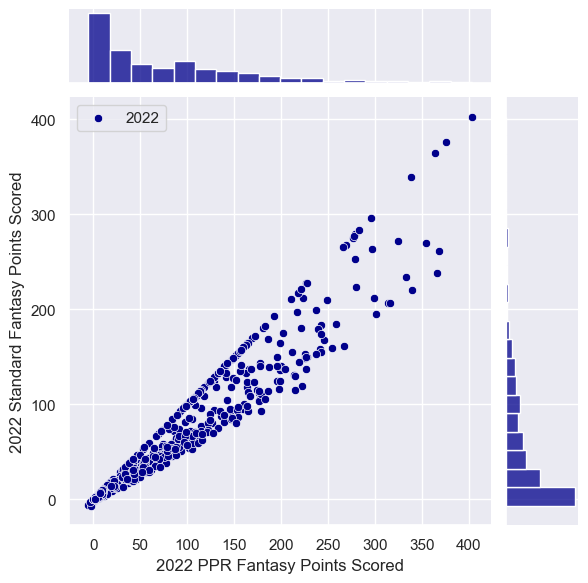

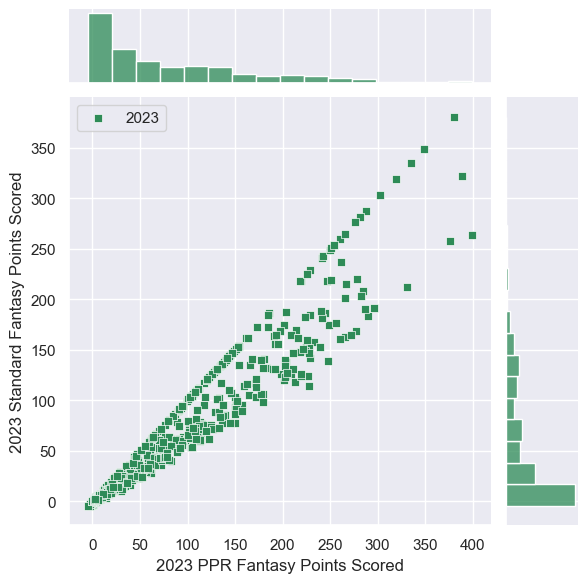

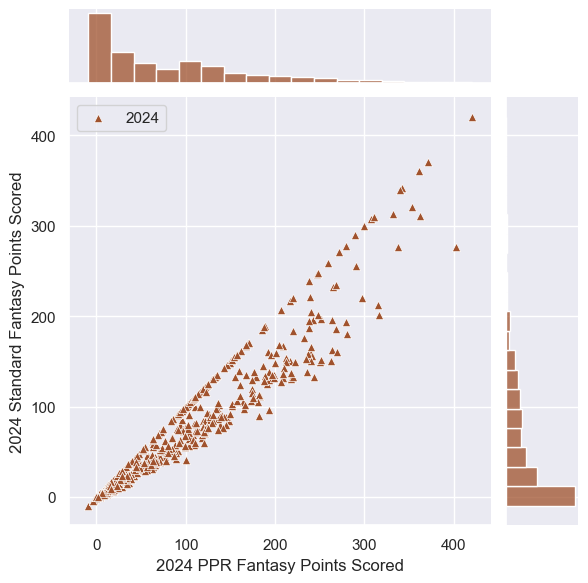

In [66]:
fantasy_feature_jointplotter("PPR Fantasy Points Scored", "Standard Fantasy Points Scored")

## Correlation Matrice

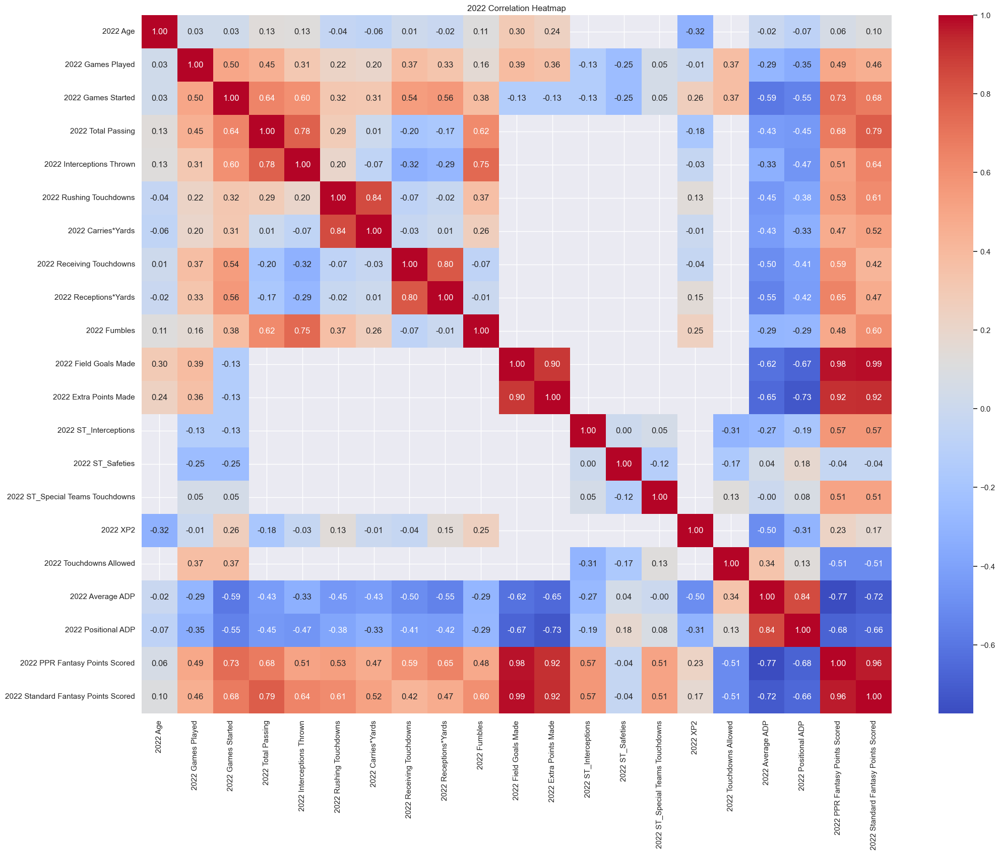

In [86]:
corr_2022 = df[['2022 Age', '2022 Games Played', '2022 Games Started', '2022 Total Passing',
'2022 Interceptions Thrown', '2022 Rushing Touchdowns',
'2022 Carries*Yards', '2022 Receiving Touchdowns',
'2022 Receptions*Yards', '2022 Fumbles', '2022 Field Goals Made',
'2022 Extra Points Made', '2022 ST_Interceptions', '2022 ST_Safeties',
'2022 ST_Special Teams Touchdowns', '2022 XP2',
'2022 Touchdowns Allowed', '2022 Average ADP', '2022 Positional ADP',
'2022 PPR Fantasy Points Scored', '2022 Standard Fantasy Points Scored']].corr()

plt.figure(figsize=(24, 18))
sns.heatmap(corr_2022, annot=True, cmap='coolwarm', fmt=".2f")
plt.title('2022 Correlation Heatmap')
plt.show()

## Pairplots

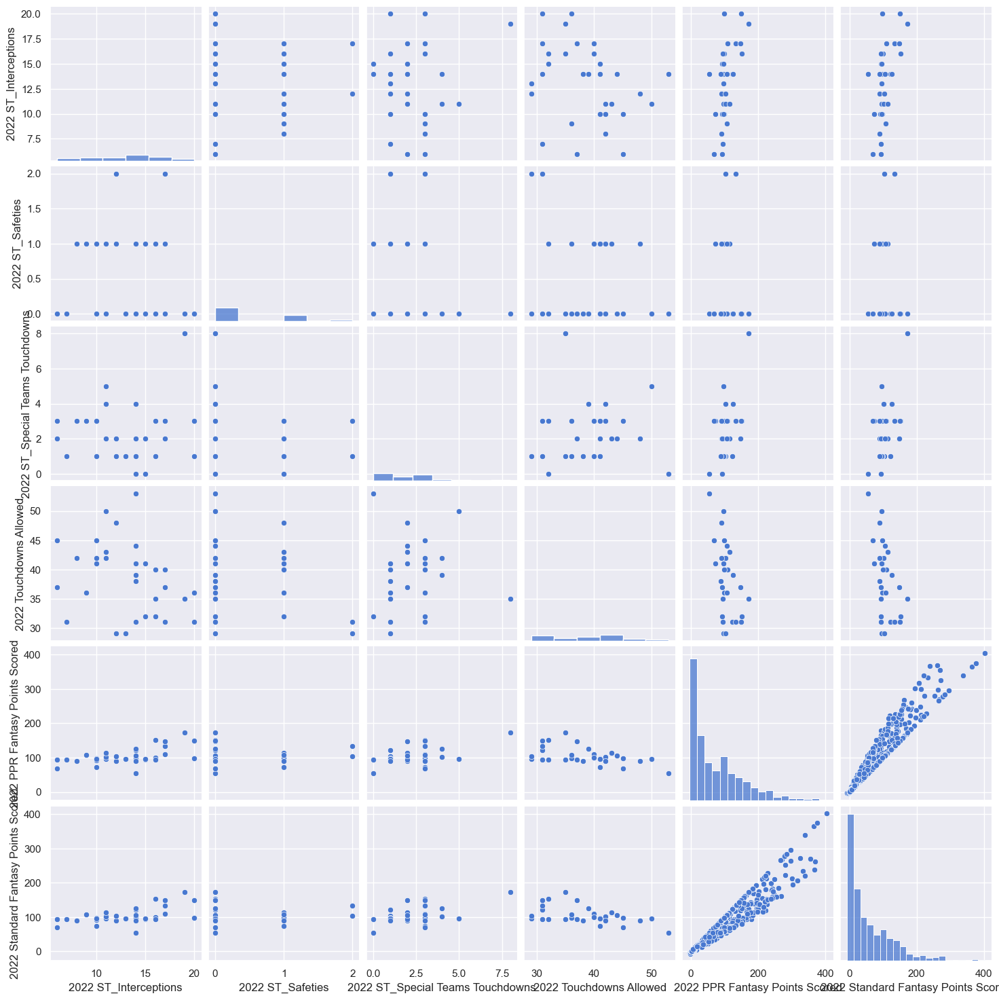

In [4]:
st_features = ['2022 ST_Interceptions', '2022 ST_Safeties', '2022 ST_Special Teams Touchdowns',
               '2022 Touchdowns Allowed', '2022 PPR Fantasy Points Scored', '2022 Standard Fantasy Points Scored']
sns.pairplot(data=df[st_features])

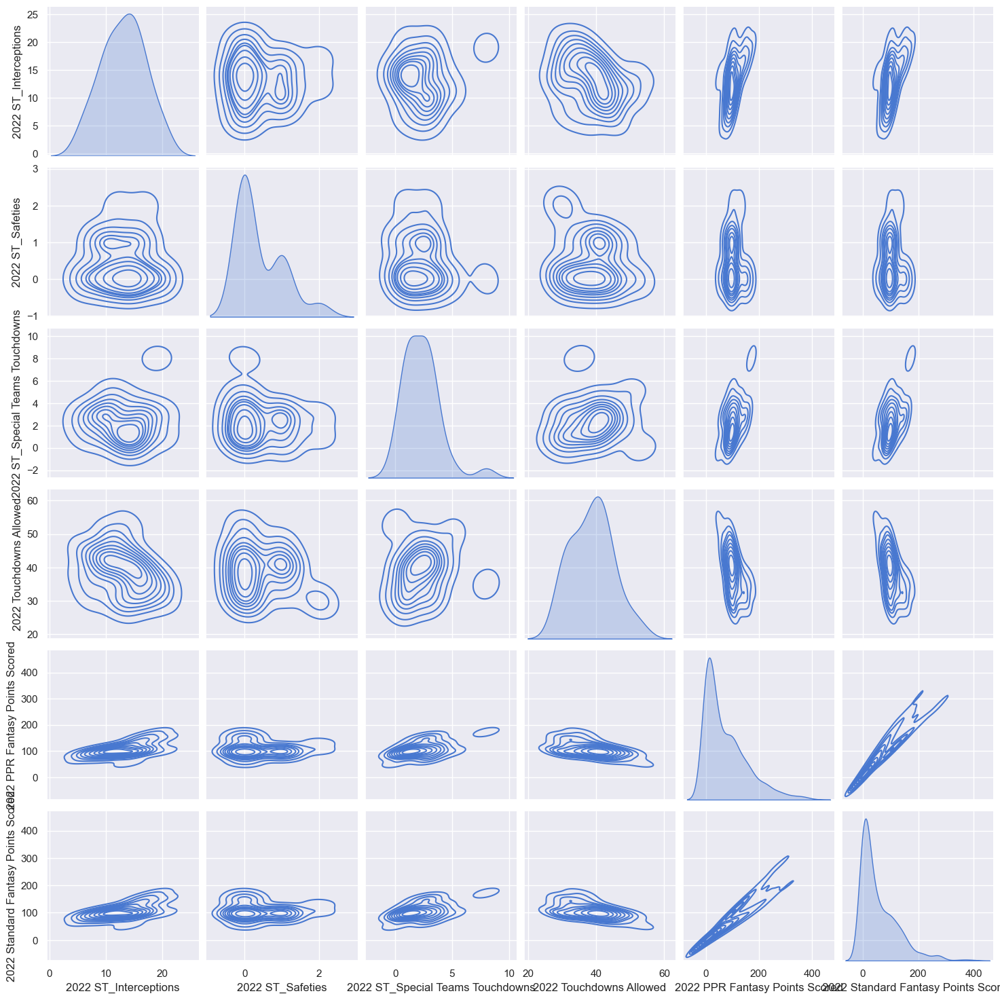

In [5]:
sns.pairplot(data=df[st_features], kind='kde')

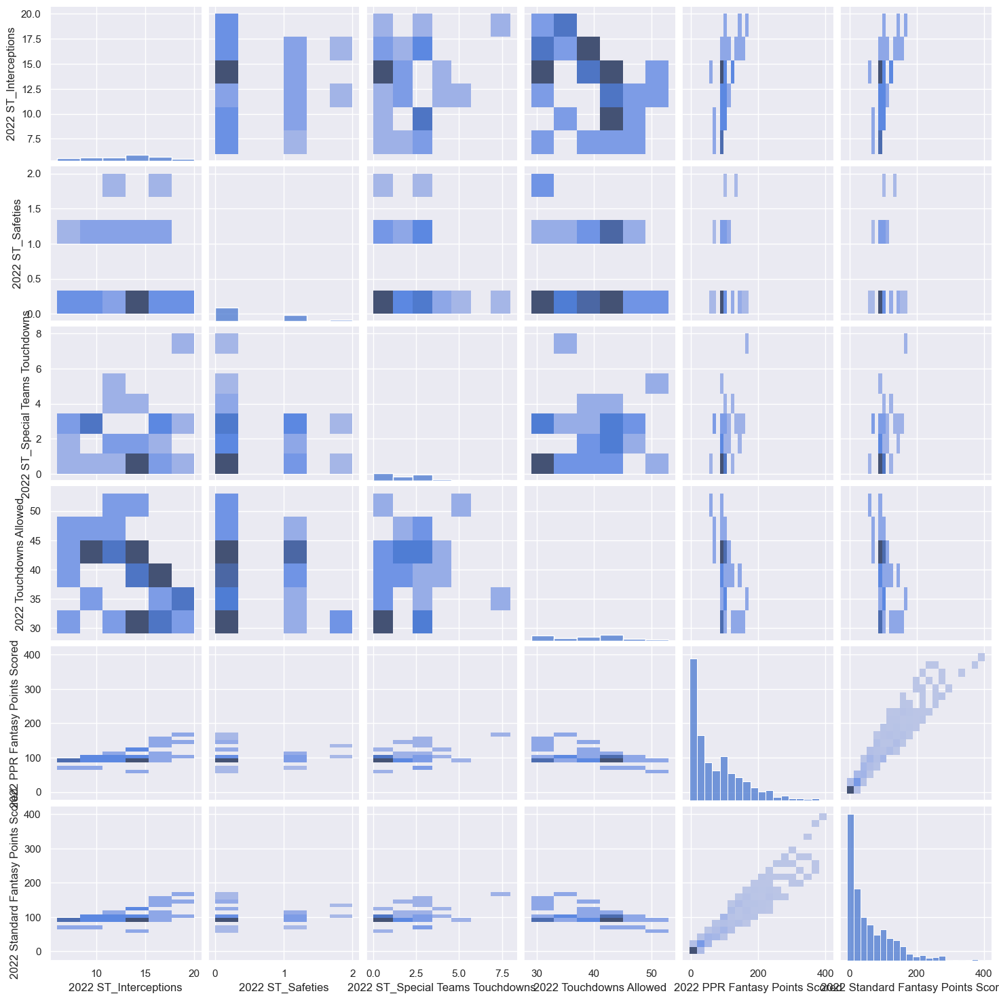

In [6]:
sns.pairplot(data=df[st_features], kind='hist')

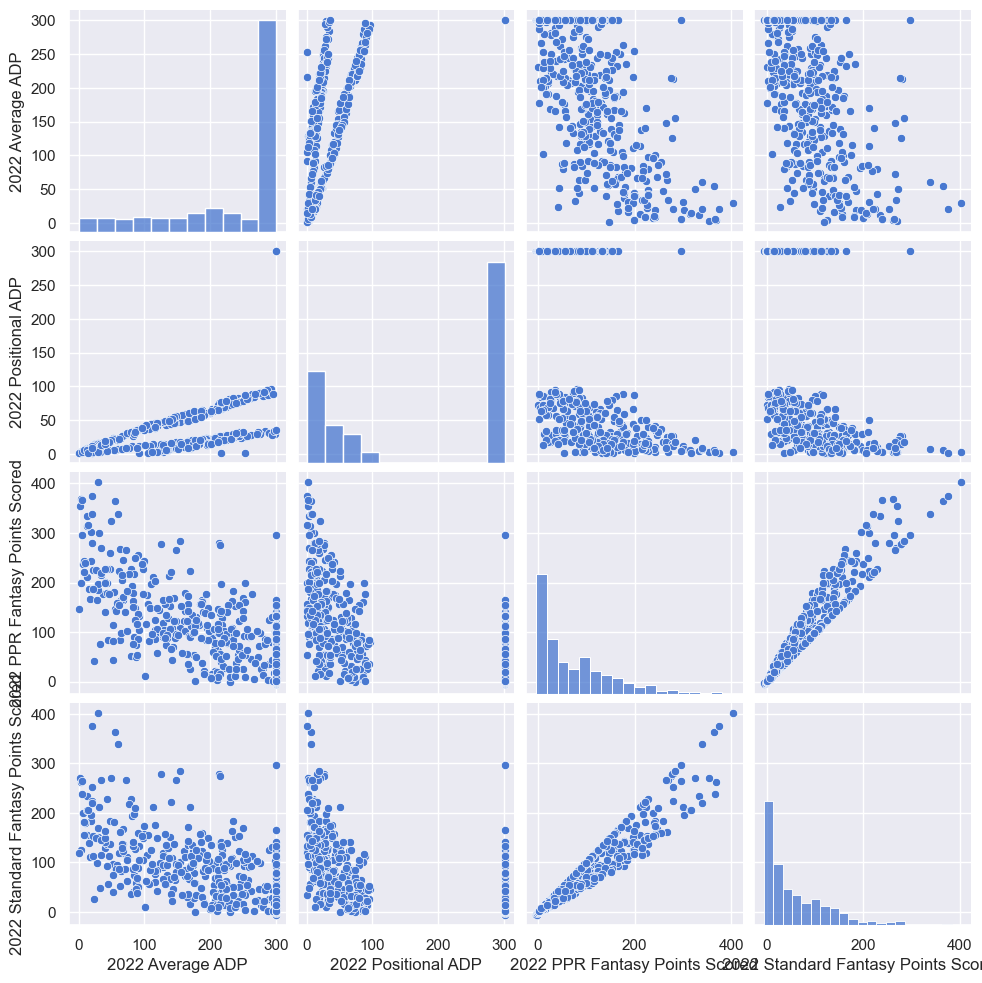

In [7]:
fantasy_feat = ['2022 Average ADP', '2022 Positional ADP', '2022 PPR Fantasy Points Scored', '2022 Standard Fantasy Points Scored']
sns.pairplot(data=df[fantasy_feat])

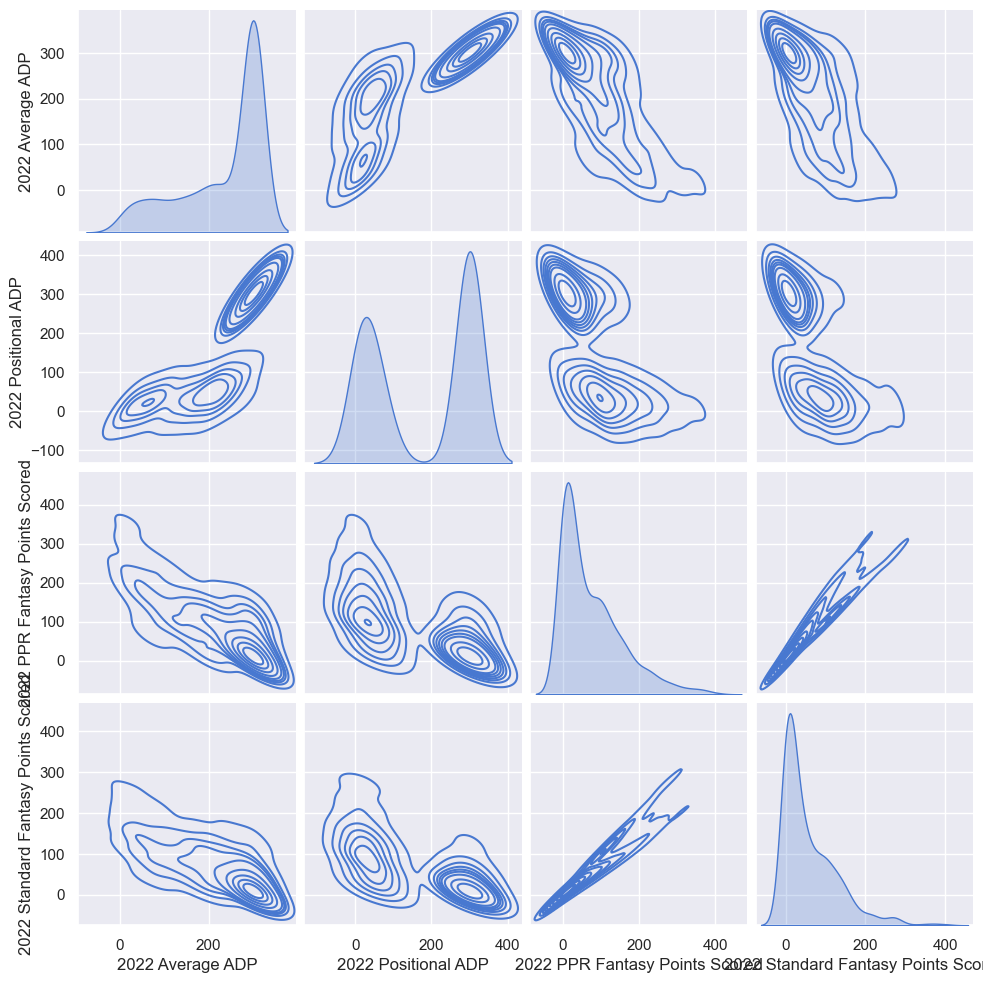

In [9]:
sns.pairplot(data=df[fantasy_feat], kind='kde')

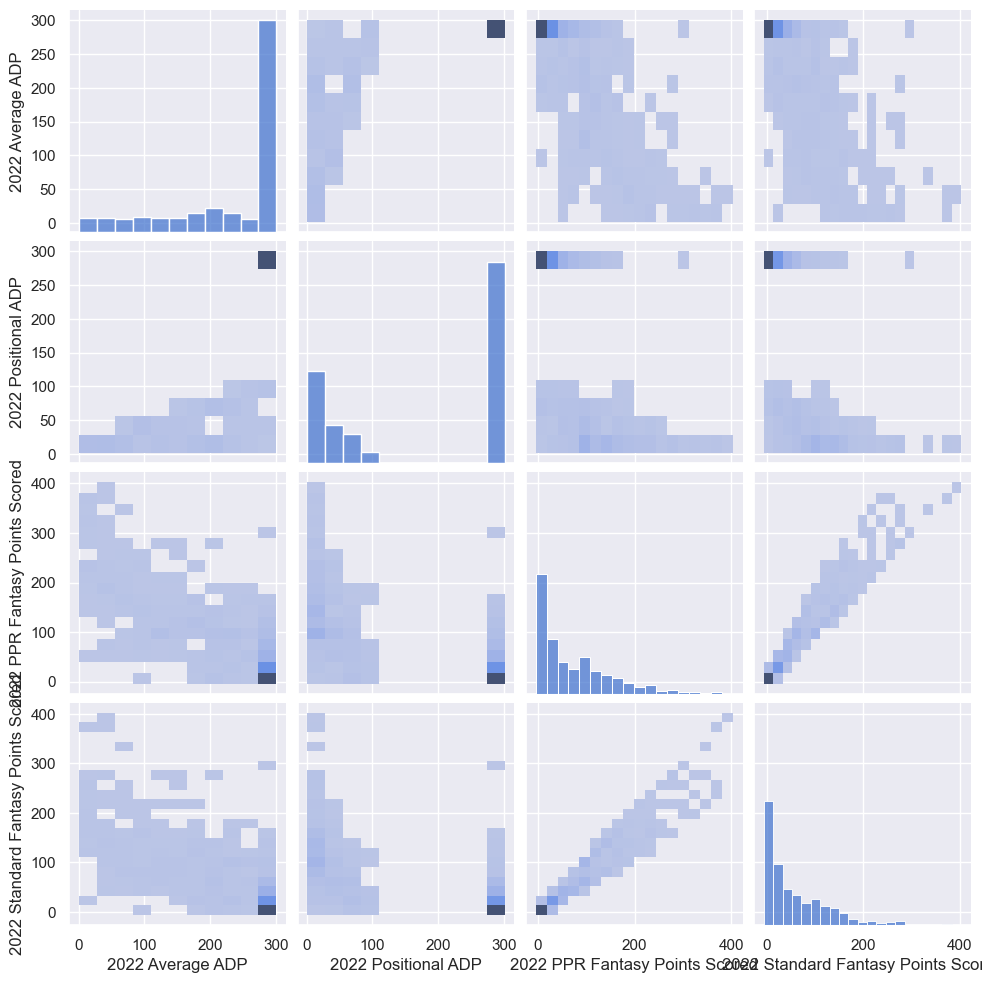

In [10]:
sns.pairplot(data=df[fantasy_feat], kind='hist')

#### Better plots

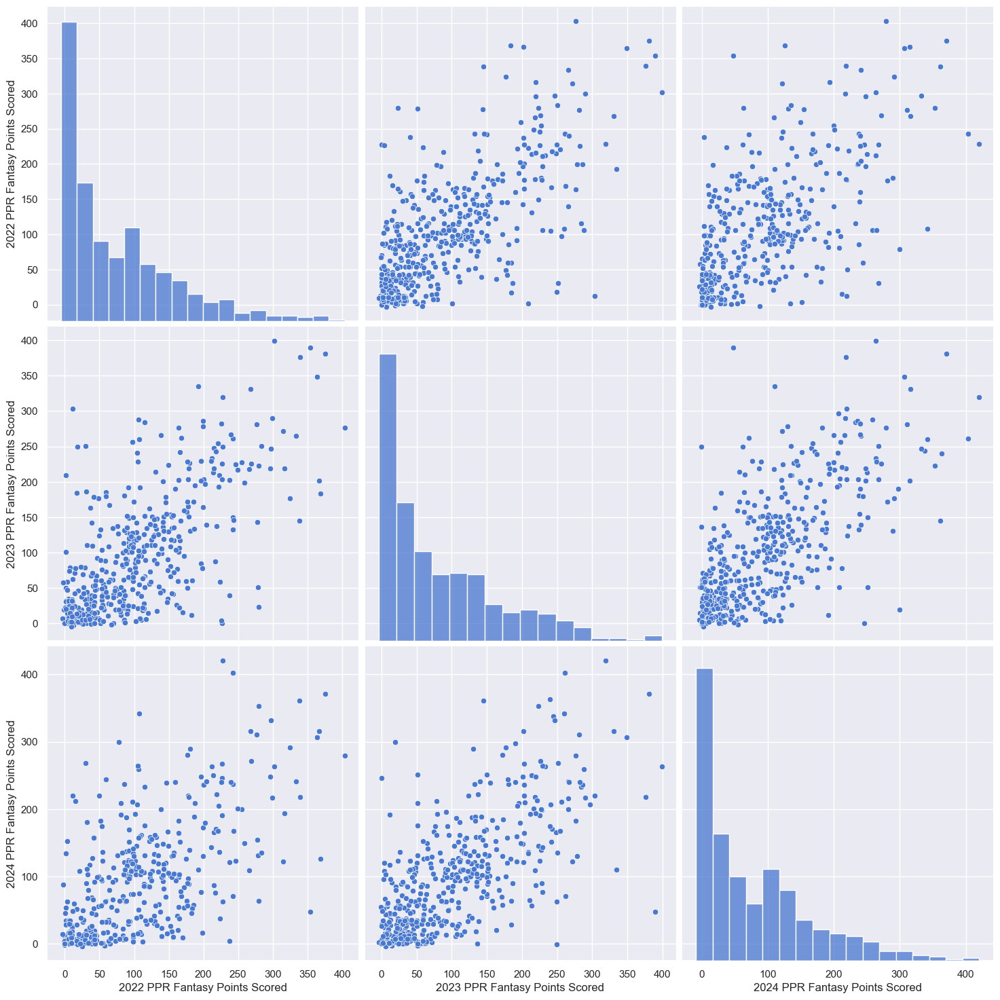

In [73]:
fantasy_featyear = ['2022 PPR Fantasy Points Scored', '2023 PPR Fantasy Points Scored', '2024 PPR Fantasy Points Scored']

# plt.figure(figsize=(15, 12))
sns.pairplot(data=df[fantasy_featyear],height=5)
plt.show()

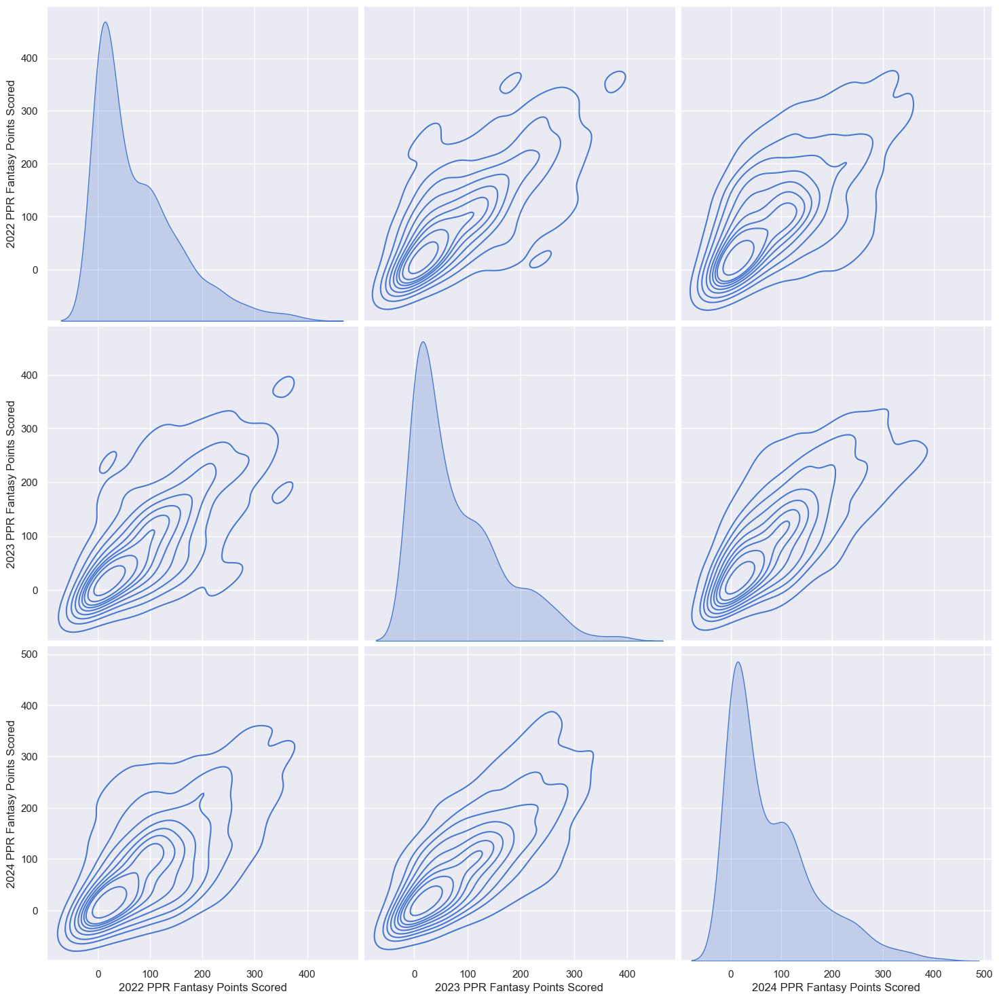

In [74]:
sns.pairplot(data=df[fantasy_featyear], height=5, kind='kde')
plt.show()

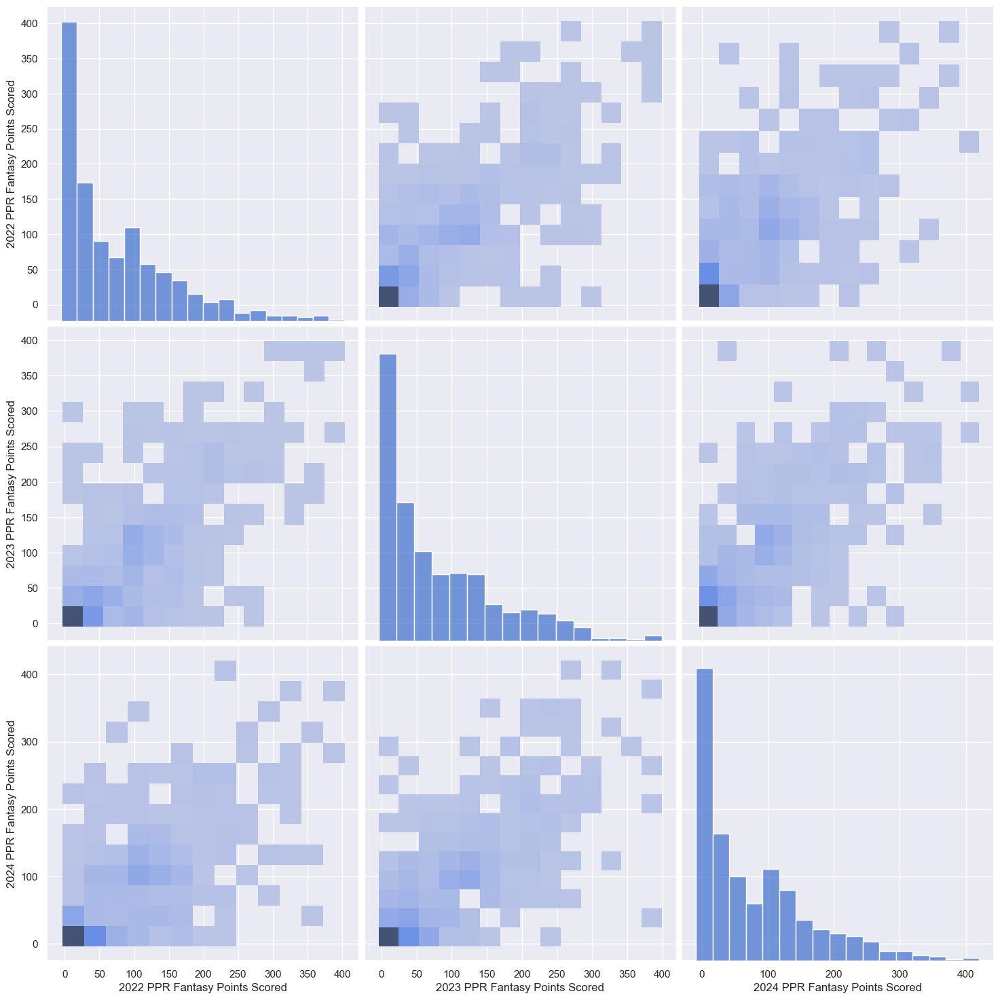

In [75]:
sns.pairplot(data=df[fantasy_featyear], height=5, kind='hist')
plt.show()

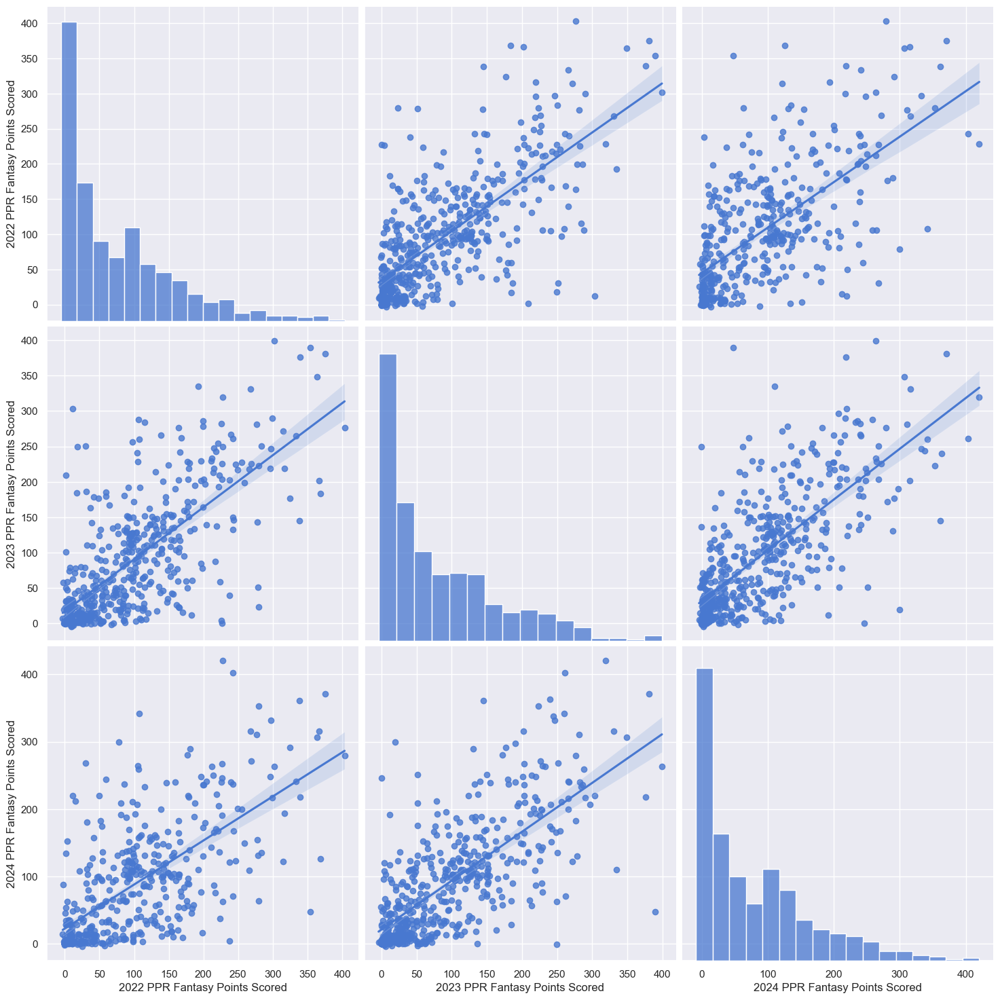

In [77]:
sns.pairplot(data=df[fantasy_featyear], height=5, kind='reg')
plt.show()

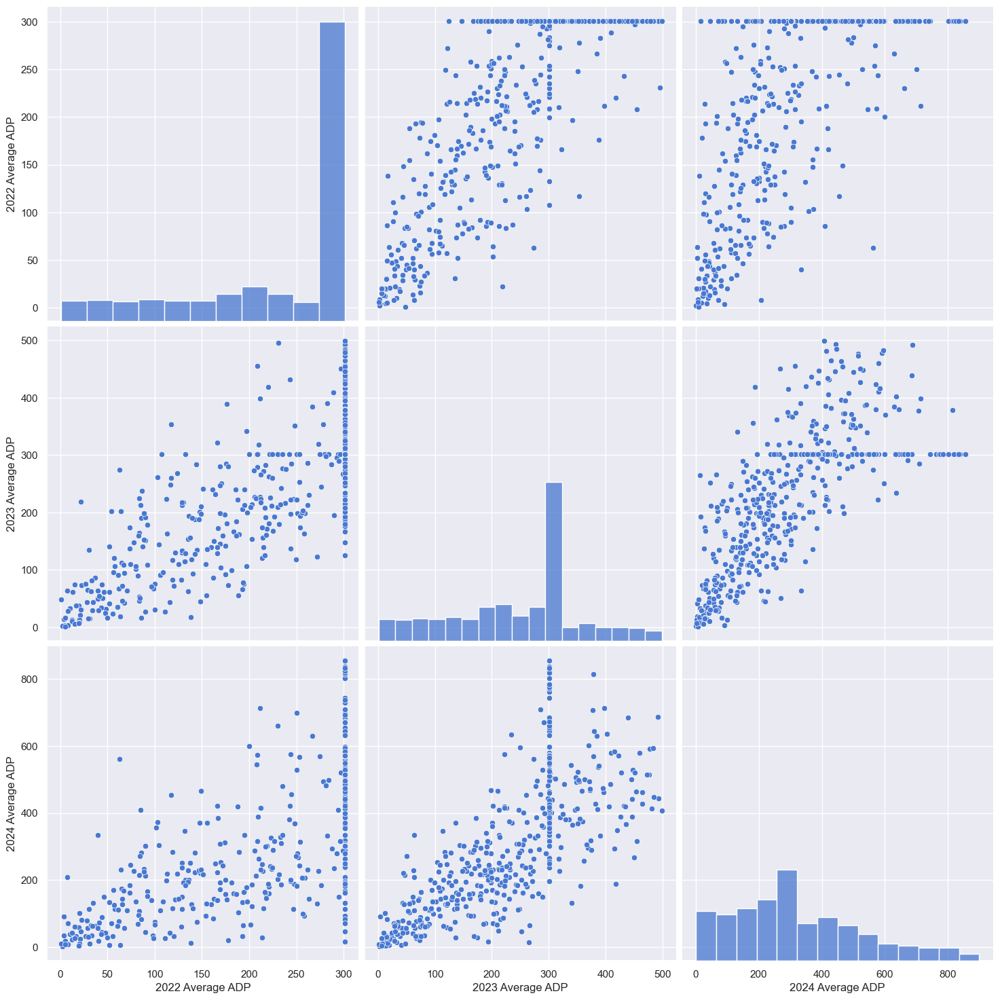

In [79]:
sns.pairplot(data=df[['2022 Average ADP', '2023 Average ADP', '2024 Average ADP']], height=5)
plt.show()

Calculation error in 2023 and 2024 Average ADP? We see the max is 499 and 899 respectively. I thought we capped it at 301. Note that 2022 is capped at 301

In [81]:
print(max(df["2022 Average ADP"]))
print(max(df["2023 Average ADP"]))
print(max(df["2024 Average ADP"]))

301.0
499.0
899.0


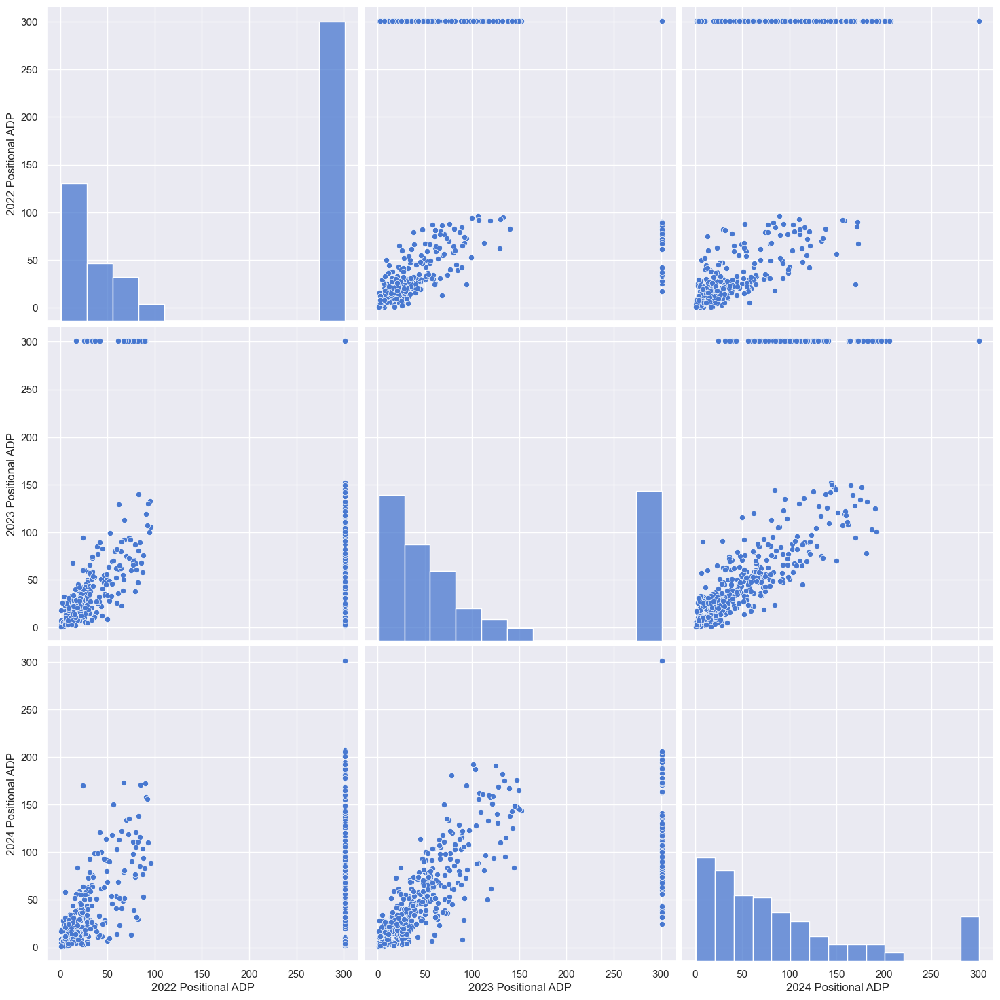

In [87]:
sns.pairplot(data=df[['2022 Positional ADP', '2023 Positional ADP', '2024 Positional ADP']], height=5)
plt.show()

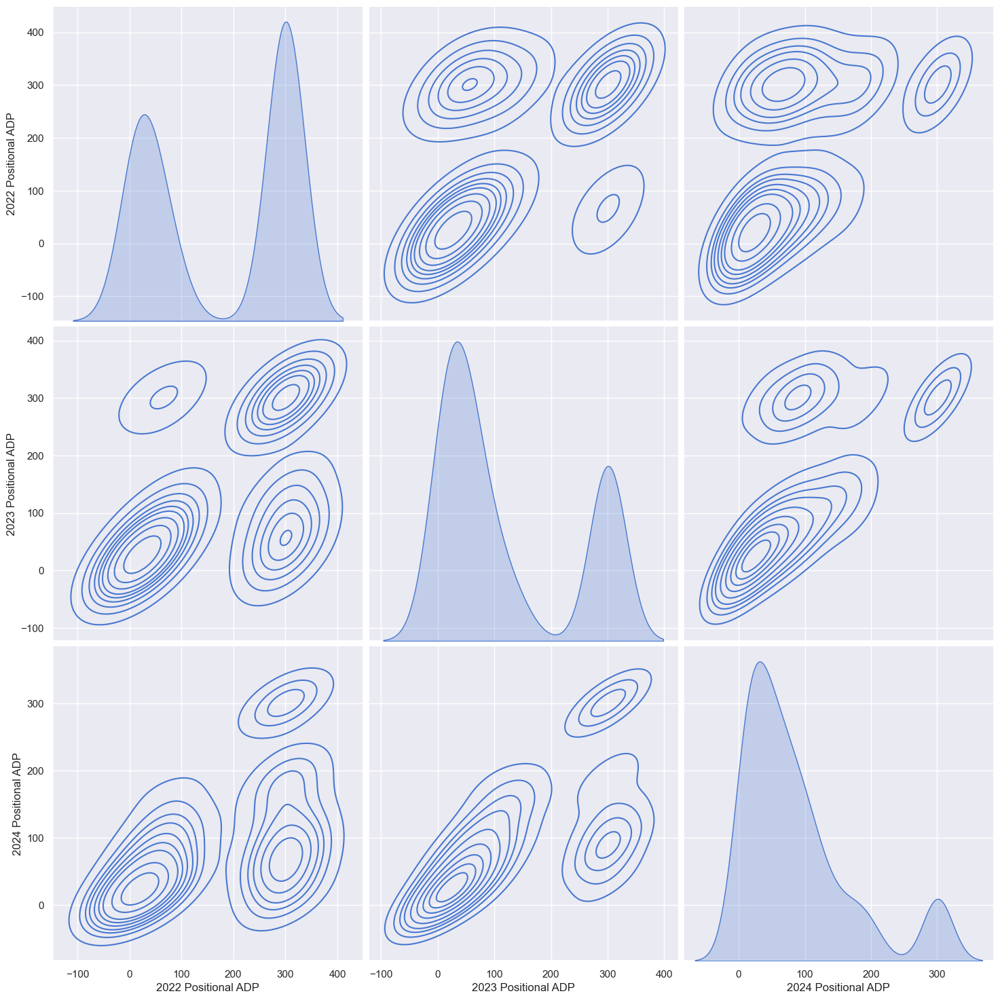

In [86]:
sns.pairplot(data=df[['2022 Positional ADP', '2023 Positional ADP', '2024 Positional ADP']], height=5, kind='kde')
plt.show()

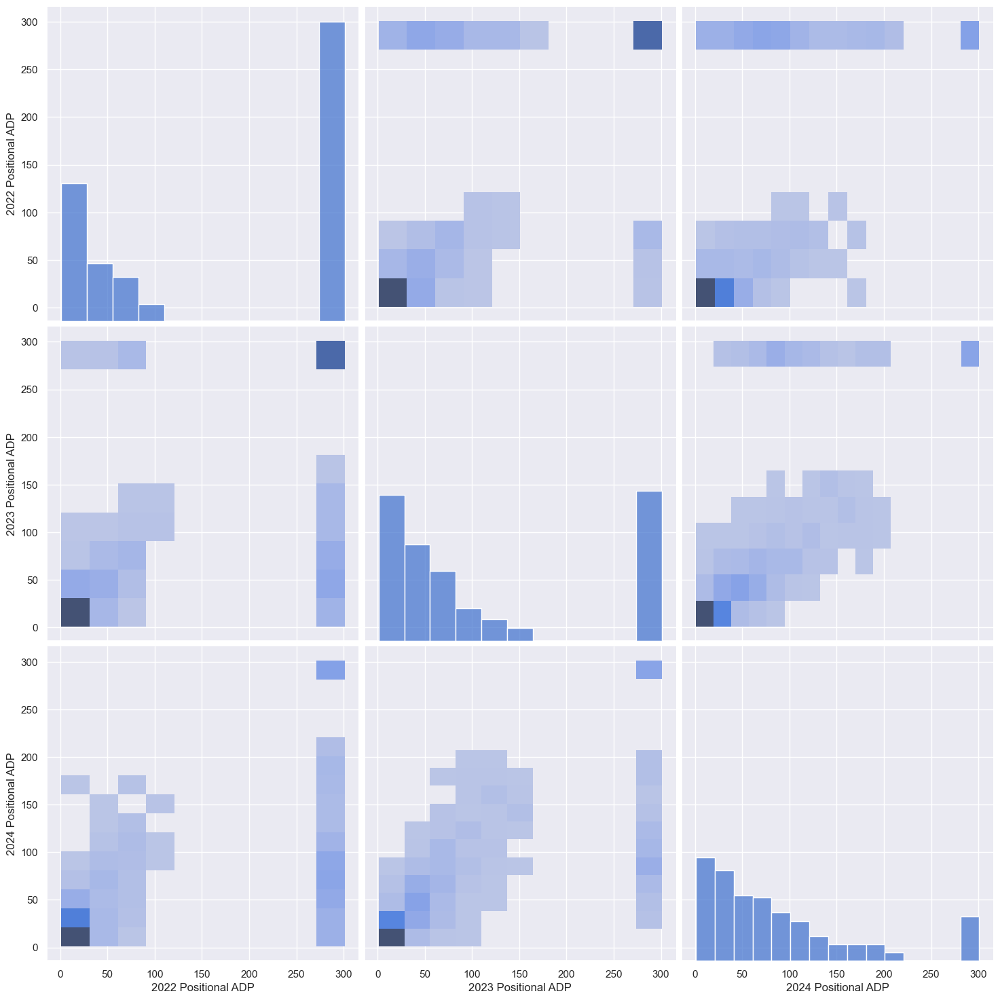

In [85]:
sns.pairplot(data=df[['2022 Positional ADP', '2023 Positional ADP', '2024 Positional ADP']], height=5, kind='hist')
plt.show()

Why are there so many more 301s for the earlier years? Are players who only played in 2024 given 301 in the 2 earlier years rather than a null value? That would probably cause this.

In [89]:
df[df['2022 Games Played'].isnull() == True]

,Player Name,2022 Age,2022 Position,2022 Team,2022 Games Played,2022 Games Started,2022 Total Passing,2022 Interceptions Thrown,2022 Rushing Touchdowns,2022 Carries*Yards,...,2024 Extra Points Made,2024 ST_Interceptions,2024 ST_Safeties,2024 ST_Special Teams Touchdowns,2024 XP2,2024 Touchdowns Allowed,2024 Average ADP,2024 Positional ADP,2024 PPR Fantasy Points Scored,2024 Standard Fantasy Points Scored
2,A.J. McCarron,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,A.T. Perry,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,AJ Barner,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,395.0,58.0,78.5,48.5
5,AJ Cole III,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,301.0,301.0,0.0,0.0
9,Aaron Shampklin,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,726.0,124.0,1.7,1.7
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
956,Zach Charbonnet,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,147.4,44.0,186.9,144.9
957,Zach Davidson,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,681.0,97.0,1.5,0.5
959,Zach Evans,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
966,Zane Gonzalez,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,19.0,NaN,NaN,NaN,NaN,NaN,301.0,301.0,36.0,36.0


In [96]:
max(df[(df['2022 Games Played'].isnull() == True)]['2022 Positional ADP'])# and (df['2022 Positional ADP'].isnull() == True)]

nan

Hypothesis is false. Is there something more interesting going on?

## Creating Final Plots
fantasy_feature_scatterplotter
fantasy_feature_kdeplotter

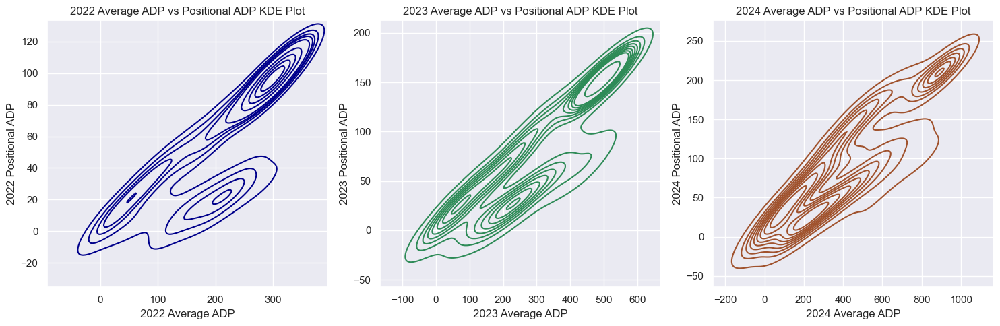

In [107]:
fantasy_feature_kdeplotter('Average ADP', 'Positional ADP')

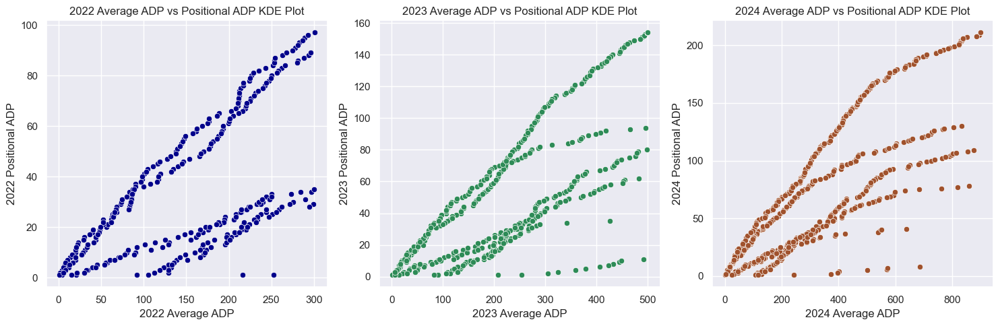

In [108]:
fantasy_feature_scatterplotter('Average ADP', 'Positional ADP')

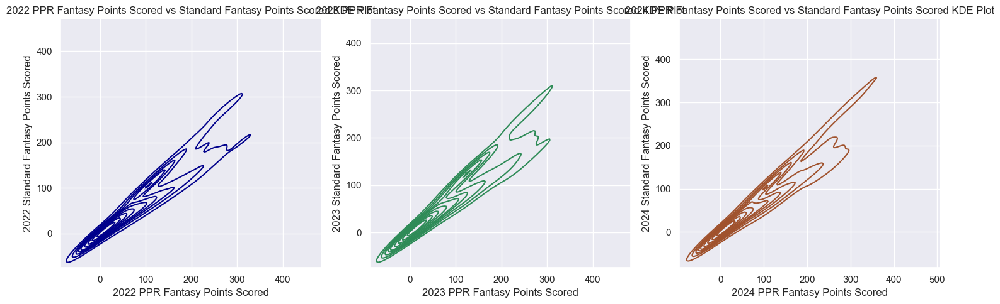

In [109]:
fantasy_feature_kdeplotter('PPR Fantasy Points Scored', 'Standard Fantasy Points Scored')

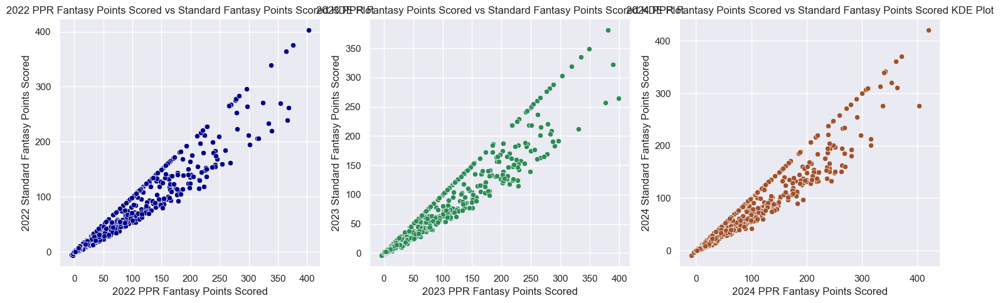

In [110]:
fantasy_feature_scatterplotter('PPR Fantasy Points Scored', 'Standard Fantasy Points Scored')

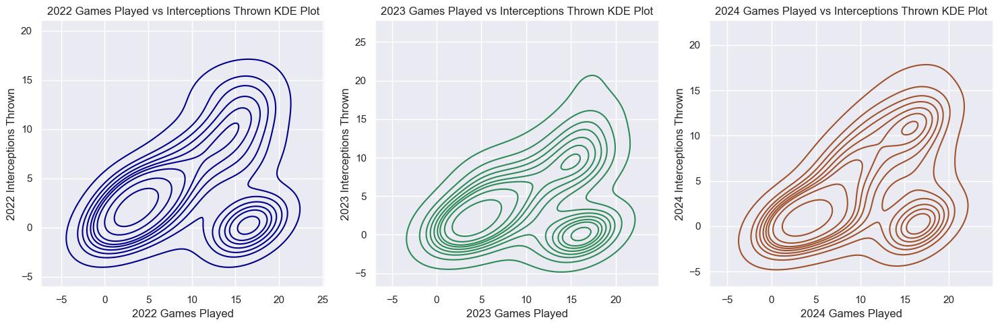

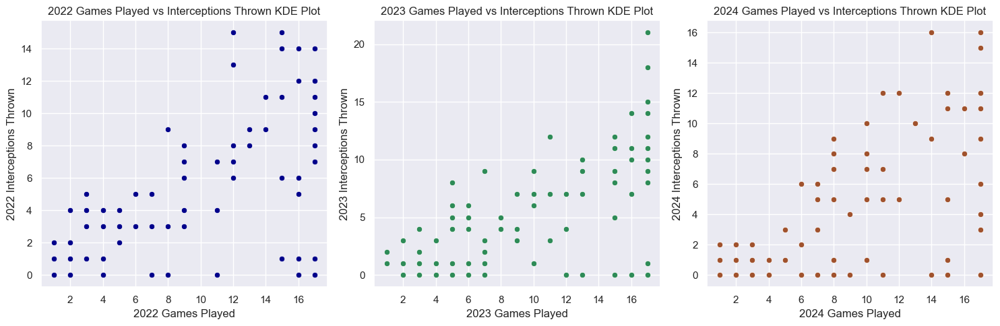

In [111]:
fantasy_feature_kdeplotter('Games Played', 'Interceptions Thrown')
fantasy_feature_scatterplotter('Games Played', 'Interceptions Thrown')

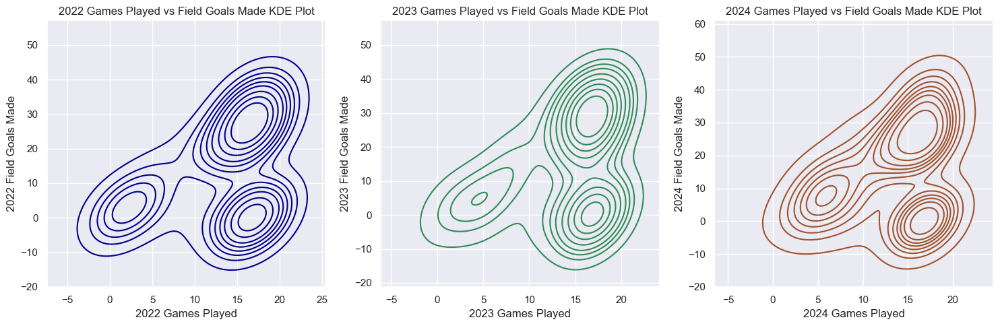

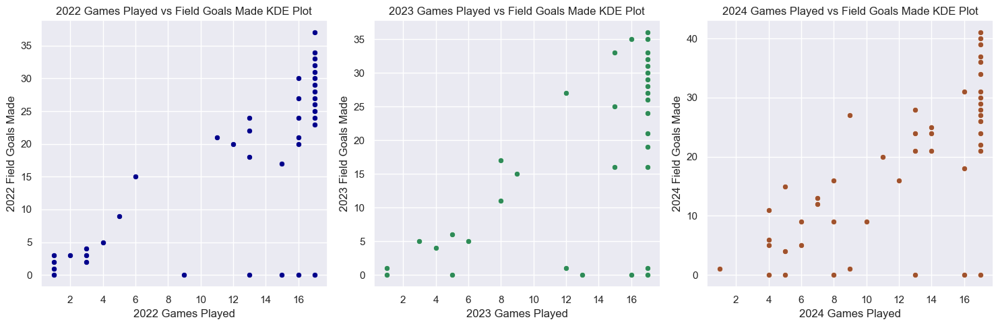

In [112]:
fantasy_feature_kdeplotter('Games Played', 'Field Goals Made')
fantasy_feature_scatterplotter('Games Played', 'Field Goals Made')

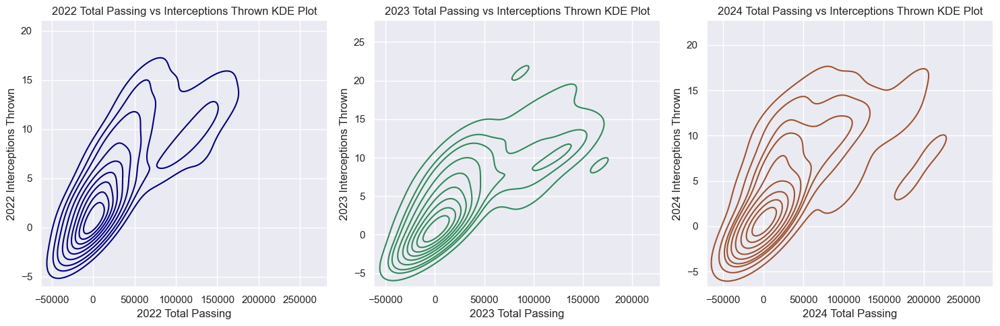

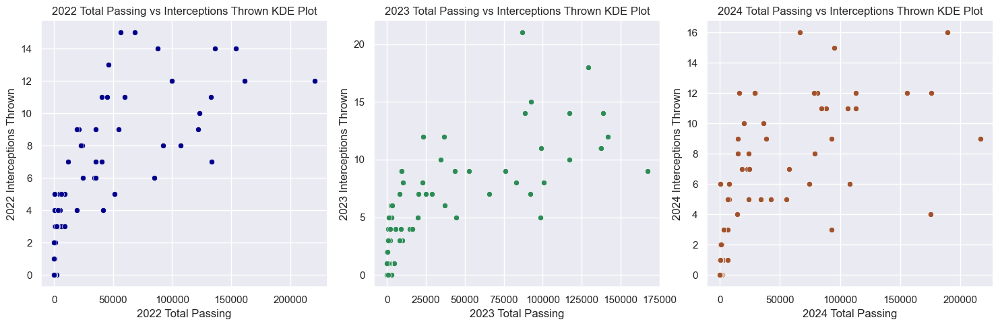

In [113]:
fantasy_feature_kdeplotter('Total Passing', 'Interceptions Thrown')
fantasy_feature_scatterplotter('Total Passing', 'Interceptions Thrown')

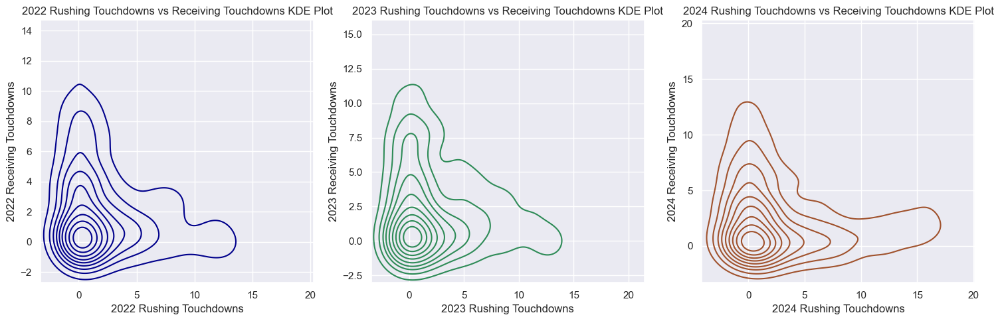

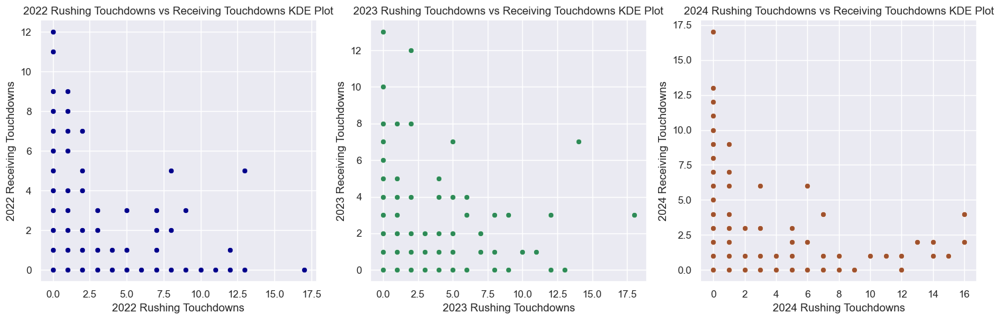

In [116]:
fantasy_feature_kdeplotter('Rushing Touchdowns', 'Receiving Touchdowns')
fantasy_feature_scatterplotter('Rushing Touchdowns', 'Receiving Touchdowns')

There's a clear bifurcation of touchdowns between Recieving and Rushing. Players tend to be good at one or the other.

Will plot to see if high values of both tend towards high values of fantasy points.

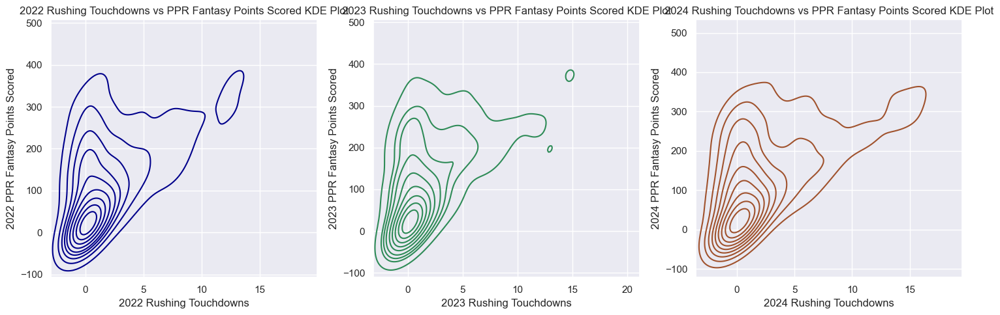

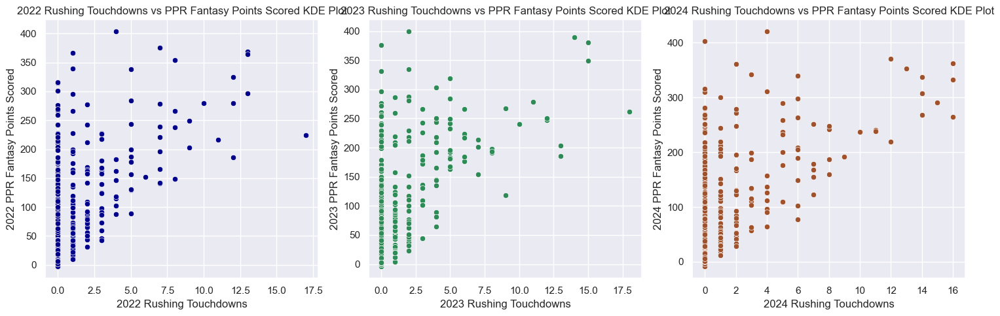

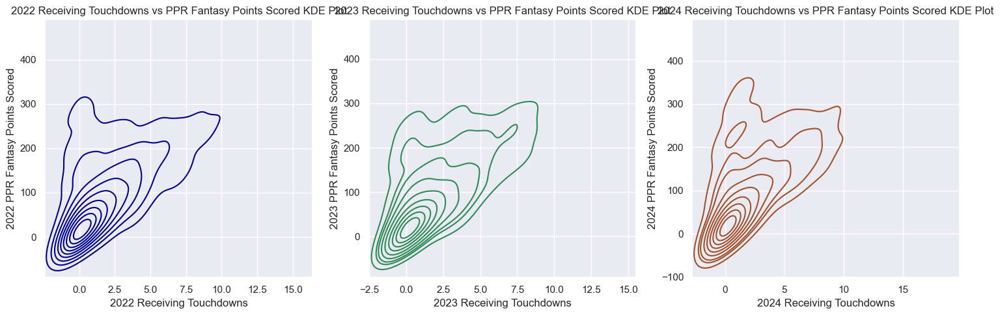

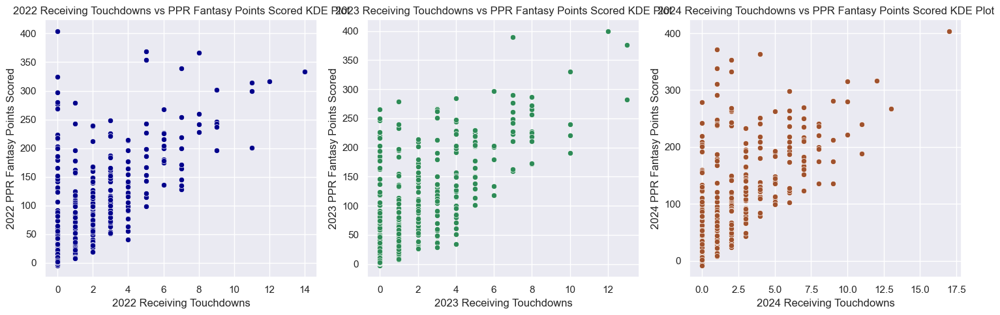

In [117]:
fantasy_feature_kdeplotter('Rushing Touchdowns', 'PPR Fantasy Points Scored')
fantasy_feature_scatterplotter('Rushing Touchdowns', 'PPR Fantasy Points Scored')
fantasy_feature_kdeplotter('Receiving Touchdowns', 'PPR Fantasy Points Scored')
fantasy_feature_scatterplotter('Receiving Touchdowns', 'PPR Fantasy Points Scored')

This clearly shows the importance of having different players good at receiving and rushing. 

In [ ]:
fantasy_feature_kdeplotter('Total Passing', 'Interceptions Thrown')
fantasy_feature_scatterplotter('Total Passing', 'Interceptions Thrown')

In [103]:
feature_cols

['Age',
 'Games Played',
 'Games Started',
 'Total Passing',
 'Interceptions Thrown',
 'Rushing Touchdowns',
 'Carries*Yards',
 'Receiving Touchdowns',
 'Receptions*Yards',
 'Fumbles',
 'Field Goals Made',
 'Extra Points Made',
 'ST_Interceptions',
 'ST_Safeties',
 'ST_Special Teams Touchdowns',
 'XP2',
 'Touchdowns Allowed',
 'Average ADP',
 'Positional ADP',
 'PPR Fantasy Points Scored',
 'Standard Fantasy Points Scored']

In [ ]:
fantasy_feature_kdeplotter('Total Passing', 'Interceptions Thrown')
fantasy_feature_scatterplotter('Total Passing', 'Interceptions Thrown')